## Построение графа взаимочастотности, где узлы — (слово, POS-tag), а рёбра отображают последовательности слов в тексте. Код заимствован из эксперимента «Graph-Based Siamese Network for Authorship Verification», где на подобных графах происходило обучение нейросетки.

In [1]:
# from google.colab import files
import networkx as nx
import os
    #from pymystem3.mystem import Mystem
import pandas as pd
import math
import re
from tqdm import tqdm

In [ ]:
from google.colab import drive
drive.mount('drive')

Mounted at drive


In [ ]:
%%capture
!unzip "/content/drive/MyDrive/ГРАФЫ/fandoms.zip" -d "/content"

In [ ]:
texts_dict = {'filename': [], 'text': []}

folder_path = './fandoms/'
for filename in os.listdir(folder_path):
    with open(folder_path + filename, 'r', encoding='utf-8') as text_file:
        text = text_file.read()
    with open(folder_path + filename, 'r', encoding='utf-8') as text_file:
        lines = text_file.readlines()
    lines = [re.sub(r'={15,}', '', text) for text in lines]
    lines = [re.sub(r'\n', '', text) for text in lines]
    lines = [line for line in lines if len(line) > 0]
    mean_length = 0
    for line in lines:
        mean_length += len(line)
    if mean_length/len(lines) > 60:
        texts_dict['filename'].append(filename.split('.')[0])
        texts_dict['text'].append(text)

In [ ]:
df = pd.DataFrame(texts_dict)
df

,filename,text
0,10857_108456,Я стояла и ошарашенно смотрела на невероятно к...
1,10857_120026,Обычная городская квартира. В не менее посредс...
2,10857_120659,"С момента, когда уставший после операции Браги..."
3,10857_121352,"...Она бежала, неслась изо всех сил, продираяс..."
4,10857_127251,"Подожди, дай сделать ещё вдох и попрощаться, м..."
...,...,...
4374,94_9083077,На столе моем стоит в рамочке картинка.\nНа ка...
4375,94_9675582,Молчание затягивалось.\nЯ медленно встал с кро...
4376,94_9702631,Понедельник\nПроснулся с жуткой головной болью...
4377,94_9735487,\nТьма и золото на плечах невесты.\nСкользит к...


#1. PREPROCESSING WITH MYSTEM

Токенизируем, лемматизируем

In [ ]:
analyzer= Mystem()
def preprocess_mystem(text):
  tokens = []
  extra_pattern = re.compile(r'(?P<ENG>^[a-z]+)|(?P<NUM>^[0-9]+)|(?P<UNK>^[а-яё])', flags=re.I)
  punct_pattern = re.compile(r'[^\w\s]')
  text = re.sub(r'РЕКЛАМА\n(•\n)?(16\+|18\+|[A-Z]+)?', '', text)
  text = re.sub(r'={15,}', '', text)
  analyzed_text = analyzer.analyze(text)
  for token_info in analyzed_text:
    if token_info.get('analysis'):
      tokens.append((token_info['analysis'][0]['lex'], re.match(r'^\w+', token_info['analysis'][0]['gr']).group(0)))
    else:
      try:
        tokens.append((token_info['text'].lower(), extra_pattern.match(token_info['text']).lastgroup))
      except AttributeError:
        punct_marks = punct_pattern.findall(token_info['text'])
        for punct in punct_marks:
          tokens.append((punct, 'PUNCT'))
  return tokens

In [ ]:
tqdm.pandas(colour='#000000')
df['preprocessed_text'] = df['text'].progress_apply(preprocess_mystem)
df

100%|███████████████████████████████████████████████████████████████████| 4379/4379 [11:57<00:00,  6.10it/s]


,filename,text,preprocessed_text
0,10857_108456,Я стояла и ошарашенно смотрела на невероятно к...,"[(я, SPRO), (стоять, V), (и, CONJ), (ошарашенн..."
1,10857_120026,Обычная городская квартира. В не менее посредс...,"[(обычный, A), (городской, A), (квартира, S), ..."
2,10857_120659,"С момента, когда уставший после операции Браги...","[(с, PR), (момент, S), (,, PUNCT), (когда, CON..."
3,10857_121352,"...Она бежала, неслась изо всех сил, продираяс...","[(., PUNCT), (., PUNCT), (., PUNCT), (она, SPR..."
4,10857_127251,"Подожди, дай сделать ещё вдох и попрощаться, м...","[(подождать, V), (,, PUNCT), (давать, V), (сде..."
...,...,...,...
4374,94_9083077,На столе моем стоит в рамочке картинка.\nНа ка...,"[(на, PR), (стол, S), (мой, APRO), (стоять, V)..."
4375,94_9675582,Молчание затягивалось.\nЯ медленно встал с кро...,"[(молчание, S), (затягиваться, V), (., PUNCT),..."
4376,94_9702631,Понедельник\nПроснулся с жуткой головной болью...,"[(понедельник, S), (просыпаться, V), (с, PR), ..."
4377,94_9735487,\nТьма и золото на плечах невесты.\nСкользит к...,"[(тьма, S), (и, CONJ), (золото, S), (на, PR), ..."


In [ ]:
!pip install dill

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 116.3/116.3 kB 2.9 MB/s eta 0:00:00


In [ ]:
import dill
with open('full_mystem_cleaned_5.pkl', 'wb') as f:
    dill.dump(df, f)

# 2. BUILDING GRAPHS

In [ ]:
!pip install torch_geometric

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.1/1.1 MB 4.1 MB/s eta 0:00:0000:0100:010m
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.2/1.2 MB 7.2 MB/s eta 0:00:00a 0:00:01m
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 301.6/301.6 KB 9.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 239.5/239.5 KB 7.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 124.3/124.3 KB 5.5 MB/s eta 0:00:00


In [2]:
import networkx as nx
import time
from itertools import chain
from collections import deque, Counter
from sys import getsizeof, stderr
import os
import matplotlib.pyplot as plt
import numpy as np
from sklearn.preprocessing import OneHotEncoder
from torch_geometric import utils
import torch
from tqdm import tqdm
from joblib import Parallel, delayed
import sys
from torch_geometric.utils import convert, softmax

Далее идёт код построения и визуализации графов, заимствованный из работы [«Graph-Based Siamese Network for authorship Verification»](https://www.researchgate.net/publication/357906614_Graph-Based_Siamese_Network_for_Authorship_Verification)

Класс ToGraph, который создаёт графы из текста (логика создания графа); Класс ToCoocurrence, который создаёт графы из предобработанного текста, подающегося в виде пар (слово, POS-tag)

In [ ]:
import dill
with open(r'full_mystem_cleaned_5.pkl', 'rb') as f:
    df = dill.load(f)
df

,filename,text,preprocessed_text
0,10857_108456,Я стояла и ошарашенно смотрела на невероятно к...,"[(я, SPRO), (стоять, V), (и, CONJ), (ошарашенн..."
1,10857_120026,Обычная городская квартира. В не менее посредс...,"[(обычный, A), (городской, A), (квартира, S), ..."
2,10857_120659,"С момента, когда уставший после операции Браги...","[(с, PR), (момент, S), (,, PUNCT), (когда, CON..."
3,10857_121352,"...Она бежала, неслась изо всех сил, продираяс...","[(., PUNCT), (., PUNCT), (., PUNCT), (она, SPR..."
4,10857_127251,"Подожди, дай сделать ещё вдох и попрощаться, м...","[(подождать, V), (,, PUNCT), (давать, V), (сде..."
...,...,...,...
4374,94_9083077,На столе моем стоит в рамочке картинка.\nНа ка...,"[(на, PR), (стол, S), (мой, APRO), (стоять, V)..."
4375,94_9675582,Молчание затягивалось.\nЯ медленно встал с кро...,"[(молчание, S), (затягиваться, V), (., PUNCT),..."
4376,94_9702631,Понедельник\nПроснулся с жуткой головной болью...,"[(понедельник, S), (просыпаться, V), (с, PR), ..."
4377,94_9735487,\nТьма и золото на плечах невесты.\nСкользит к...,"[(тьма, S), (и, CONJ), (золото, S), (на, PR), ..."


In [ ]:
class ToGraph:
    """Parent class to generate networkx graph from parsed text"""

    def __init__(self, graph_type='Graph'):
        self.graph_type = graph_type
        if graph_type == 'MultiDiGraph':
            self.G = nx.MultiDiGraph()
        elif graph_type == 'MultiGraph':
            self.G = nx.MultiGraph()
        elif graph_type == 'DiGraph':
            self.G = nx.DiGraph()
        elif graph_type == 'Graph':
            self.G = nx.Graph()
        else:
            print('invalid graph type')
            exit()

    def node_label(self, word):
        """Set the name of each node"""

        return word

    def grown_graph(self, text):
        """Add nodes and edges from parsed text"""

        pass

    def final_tune(self, remove_loops=True):
        """Optional final operation in graph"""

        if remove_loops is True:
            self.G.remove_edges_from(nx.selfloop_edges(self.G))

    def define_node_mask(self, measure=nx.closeness_centrality):
        """Used in unmasking"""

        # Get measure for all nodes
        nodes_measure = measure(self.G)
        return nodes_measure

    def show_graph(self, graph_id=None, dest_folder='graphs'):
        """Method for graphing multigraphs with graphviz.
        Saves the image as a file"""

        name = self.graph_type + '_' + str(graph_id) + '.png'
        if not os.path.exists(dest_folder):
            os.makedirs(dest_folder)

        path = os.path.join(dest_folder,  name)
        nx.draw_networkx(self.G)
        plt.savefig(path)


class ToCoocurrence(ToGraph):
    """Coocurrence graph from parsed text"""

    def __init__(self,
                 reduce_classes=[],
                 graph_type='Graph', weigth_labels=True):
        super().__init__(graph_type)
        self.weigth_labels = weigth_labels
        self.reduce_classes = reduce_classes

    def node_label(self, token):
        if token[1] not in self.reduce_classes:
            return token
        else:
            return (('$' + str(token[1])), token[1])

    def define_edges(self, text_tag):
        """Get list of edges. Used to test formats"""

        # Coocurrence edges loop
        edges_list = []
        node_pre = self.node_label(text_tag[0])
        for token in text_tag[1:]:
            node_act = self.node_label(token)
            edges_list.append((node_pre, node_act))
            node_pre = node_act

        total = len(edges_list)
        edges = [(node_pre, node_act, (c / total))
                 for (node_pre, node_act), c in Counter(edges_list).items()]
        return edges

    def grown_from_edges(self, edges):
        """Add edges to graph. Used to test formats"""

        self.G.add_weighted_edges_from(edges)
        # self.final_tune()

    def grown_graph(self, text_tag):
        edges = self.define_edges(text_tag)
        self.grown_from_edges(edges)

    def to_sparse_raw(self):
        """Transform to scipy sparse array and node list"""

        node_names = list(self.G.nodes())
        sparse = nx.convert_matrix.to_scipy_sparse_array(self.G)
        return sparse, node_names

    def to_sparse(self, return_node_words=False):
        """Transform to scipy sparse matrix. Used to test formats"""
        node_pos = [node[1] for node in self.G.nodes()]
        sparse = nx.convert_matrix.to_scipy_sparse_array(self.G)
        if return_node_words:
            node_words = [node for node in self.G.nodes()]
            return sparse, node_pos, node_words

        else:
            return sparse, node_pos

    def to_sparse_encoded(self):
        """Transform to scipy sparse matrix with the POS categories as attributes in sparse hue as well.
        Used to test formats"""

        sparse, node_pos = self.to_sparse()
        node_attr = encode_pos(node_pos)
        return sparse, node_attr

    def to_data(self, pos_encoder='default'):
        """Transform to pytorch tensor as it would be used in torch geometric.
        Used to test formats"""

        nx_graph = self.G
        # verify graph type
        assert type(nx_graph).__name__ in ['Graph', 'DiGraph']

        # Define graph, edges weight to edge_attr
        weight = 'weight'
        data = utils.from_networkx(nx_graph)
        data_dir = dir(data)
        if weight in data_dir:
            data['edge_attr'] = data[weight]
            delattr(data, weight)

        x_names = list(nx_graph.nodes)
        data['x_names'] = x_names

        # Convert pos in node feature and node class
        x_pos = [n[1] for n in x_names]
        if pos_encoder == 'default':
            pos_encoder = OneHotEncoder(categories=[_classes])

        x_pos = np.array(x_pos).reshape(-1, 1)
        x_sparse = pos_encoder.fit_transform(x_pos)
        x = torch.from_numpy(x_sparse.toarray())
        data['x'] = x
        return data

Создаём графы из текстов датасета

In [ ]:
def text_parsed_to_graph_sparse_raw(parsed, graph_type='DiGraph', graph_id=0):
    coocurrence = ToCoocurrence([], graph_type)
    coocurrence.grown_graph(parsed)
    print('----------ToGraph.show_attributes method')
    print('graph_type: ', coocurrence.graph_type)
    print('Nodes:', nx.number_of_nodes(coocurrence.G))
    print('Edges:', nx.number_of_edges(coocurrence.G))
    print('loops:', nx.number_of_selfloops(coocurrence.G))
    # coocurrence.show_graph(graph_id)
    return coocurrence

In [ ]:
dill.settings

{'protocol': 4, 'byref': False, 'fmode': 0, 'recurse': False, 'ignore': False}

In [ ]:
tqdm.pandas()
df['graph'] = df['preprocessed_text'].progress_apply(text_parsed_to_graph_sparse_raw)
df.head()

  0%|▎                                                                   | 20/4379 [00:00<00:27, 159.05it/s]

----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 591
Edges: 1421
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 515
Edges: 1155
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1174
Edges: 2942
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 267
Edges: 458
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 196
Edges: 340
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 326
Edges: 649
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 203
Edges: 367
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 544
Edges: 1164
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 449
Edges: 876
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 206
Edges: 328
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nod

  1%|▌                                                                    | 36/4379 [00:01<03:48, 18.97it/s]

----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 12961
Edges: 106062
loops: 11
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1768
Edges: 4715
loops: 3
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 3044
Edges: 10181
loops: 3
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 5702
Edges: 23760
loops: 8
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 6586
Edges: 28948
loops: 4
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 3460
Edges: 13007
loops: 5
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 2154
Edges: 6345
loops: 3
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 5566
Edges: 23827
loops: 4
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 6692
Edges: 31835
loops: 7
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 8909
Edges: 48329
loops: 9
----------ToGraph.show_attributes metho

  1%|▋                                                                    | 44/4379 [00:01<03:38, 19.81it/s]

----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1269
Edges: 3192
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1020
Edges: 2279
loops: 3
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1955
Edges: 5341
loops: 3
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1626
Edges: 4415
loops: 3


  1%|▉                                                                    | 59/4379 [00:02<02:55, 24.57it/s]

----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1072
Edges: 2586
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1087
Edges: 2589
loops: 3
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1399
Edges: 3577
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1613
Edges: 4321
loops: 3
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1135
Edges: 2618
loops: 3
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 2437
Edges: 7576
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 3266
Edges: 11663
loops: 4
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 3990
Edges: 14123
loops: 4
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1135
Edges: 2717
loops: 3
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 848
Edges: 1942
loops: 1
----------ToGraph.show_attributes method
graph_ty

  2%|█▏                                                                   | 78/4379 [00:02<01:47, 40.10it/s]

----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 3820
Edges: 13635
loops: 4
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1203
Edges: 2946
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1276
Edges: 2868
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 2306
Edges: 6464
loops: 4
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 3182
Edges: 10602
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1746
Edges: 4527
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1194
Edges: 2756
loops: 3
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1203
Edges: 2879
loops: 3
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1380
Edges: 3430
loops: 3
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 4021
Edges: 13739
loops: 4
----------ToGraph.show_attributes method
graph_

  2%|█▎                                                                   | 86/4379 [00:02<01:46, 40.36it/s]

----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 10224
Edges: 65313
loops: 17
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 2094
Edges: 6010
loops: 3
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 450
Edges: 927
loops: 1


  2%|█▍                                                                   | 93/4379 [00:03<02:43, 26.16it/s]

----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 290
Edges: 535
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 218
Edges: 367
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 2944
Edges: 11536
loops: 4
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 3825
Edges: 15168
loops: 6
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 487
Edges: 1020
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 866
Edges: 2144
loops: 3
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 2403
Edges: 7687
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 510
Edges: 1022
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 167
Edges: 290
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1330
Edges: 3820
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiG

  3%|█▉                                                                  | 122/4379 [00:03<01:25, 49.74it/s]

----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 5547
Edges: 31052
loops: 6
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1599
Edges: 4302
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1062
Edges: 2747
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 269
Edges: 479
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 275
Edges: 512
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1577
Edges: 4351
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1662
Edges: 5129
loops: 3
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 959
Edges: 2385
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 315
Edges: 607
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 818
Edges: 2001
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiG

  4%|██▍                                                                 | 157/4379 [00:03<00:47, 88.36it/s]

Edges: 1526
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 809
Edges: 1914
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1595
Edges: 4605
loops: 3
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 2826
Edges: 10877
loops: 5
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 929
Edges: 2206
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1340
Edges: 3769
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 269
Edges: 508
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 251
Edges: 456
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 790
Edges: 1875
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 389
Edges: 691
loops: 3
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 285
Edges: 534
loops: 1
----------ToGraph.show_attributes metho

  4%|██▊                                                                 | 185/4379 [00:04<01:11, 58.68it/s]

----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 3296
Edges: 12193
loops: 6
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1555
Edges: 4365
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1344
Edges: 3694
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 849
Edges: 1854
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 291
Edges: 584
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 243
Edges: 438
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 4884
Edges: 19348
loops: 4
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 4454
Edges: 16271
loops: 3
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 249
Edges: 521
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 2050
Edges: 5992
loops: 1
----------ToGraph.show_attributes method
graph_type:  

  5%|███▍                                                                | 220/4379 [00:04<00:44, 92.92it/s]

----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 3884
Edges: 15943
loops: 8
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 541
Edges: 1159
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 206
Edges: 348
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 3771
Edges: 14748
loops: 3
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1065
Edges: 2961
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 310
Edges: 517
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 296
Edges: 494
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 362
Edges: 641
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 303
Edges: 556
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 353
Edges: 613
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph

  6%|███▊                                                               | 247/4379 [00:05<00:40, 101.09it/s]

----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 605
Edges: 1206
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 2149
Edges: 6443
loops: 4
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1223
Edges: 2926
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 905
Edges: 2117
loops: 7
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 208
Edges: 362
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 4283
Edges: 17345
loops: 5
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 655
Edges: 1372
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1037
Edges: 2467
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1014
Edges: 2308
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1475
Edges: 3898
loops: 2
----------ToGraph.show_attributes method
graph_type:  

  6%|████▏                                                              | 270/4379 [00:05<00:32, 128.10it/s]

----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 4078
Edges: 15484
loops: 8
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 378
Edges: 783
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 668
Edges: 1471
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 406
Edges: 720
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 625
Edges: 1271
loops: 1


  7%|████▊                                                               | 307/4379 [00:06<00:57, 71.32it/s]

----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 418
Edges: 907
loops: 3
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1436
Edges: 3911
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 2983
Edges: 9664
loops: 4
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1788
Edges: 5078
loops: 4
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 2936
Edges: 10331
loops: 5
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 869
Edges: 2056
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 864
Edges: 2109
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1076
Edges: 2727
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 373
Edges: 664
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1160
Edges: 3007
loops: 3
----------ToGraph.show_attributes method
graph_type:  D

  7%|█████                                                               | 327/4379 [00:06<00:45, 88.27it/s]

----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1462
Edges: 4383
loops: 4
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 286
Edges: 481
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1787
Edges: 5573
loops: 3
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 566
Edges: 1165
loops: 3
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 852
Edges: 2073
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 259
Edges: 445
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 435
Edges: 845
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 432
Edges: 887
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 368
Edges: 711
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 556
Edges: 1113
loops: 3
----------ToGraph.show_attributes method
graph_type:  DiGraph
N

  8%|█████▌                                                              | 358/4379 [00:06<00:41, 96.45it/s]

----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 6477
Edges: 37274
loops: 4
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 2117
Edges: 6772
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 787
Edges: 2083
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1153
Edges: 3028
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 327
Edges: 701
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 596
Edges: 1419
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 4233
Edges: 18604
loops: 4
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 542
Edges: 1121
loops: 3
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 925
Edges: 2224
loops: 3
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 2226
Edges: 7191
loops: 4
----------ToGraph.show_attributes method
graph_type:  

  9%|█████▉                                                             | 390/4379 [00:06<00:35, 111.41it/s]

----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1426
Edges: 4724
loops: 3
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1002
Edges: 2454
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1212
Edges: 3557
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 2384
Edges: 8464
loops: 4
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 311
Edges: 545
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 650
Edges: 1369
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 3750
Edges: 16203
loops: 4
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1006
Edges: 2864
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 651
Edges: 1564
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 624
Edges: 1638
loops: 3
----------ToGraph.show_attributes method
graph_type:  

  9%|██████▎                                                             | 404/4379 [00:07<01:32, 42.82it/s]

----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 3274
Edges: 13134
loops: 4
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 410
Edges: 828
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 473
Edges: 982
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1855
Edges: 6156
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 2188
Edges: 7576
loops: 6
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1101
Edges: 2915
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1802
Edges: 5671
loops: 3
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 2466
Edges: 8926
loops: 4
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 525
Edges: 1141
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1037
Edges: 2659
loops: 2
----------ToGraph.show_attributes method
graph_type:  

 10%|██████▌                                                             | 424/4379 [00:07<01:15, 52.46it/s]

----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 780
Edges: 1840
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 3447
Edges: 15686
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1098
Edges: 3041
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1210
Edges: 3597
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1247
Edges: 3493
loops: 3
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 2865
Edges: 10514
loops: 4
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 3701
Edges: 17612
loops: 6
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1716
Edges: 5502
loops: 6
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 912
Edges: 2430
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 2263
Edges: 7682
loops: 4
----------ToGraph.show_attributes method
graph_ty

 10%|██████▊                                                             | 442/4379 [00:08<01:04, 60.70it/s]

----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 4219
Edges: 20513
loops: 7
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 609
Edges: 1429
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 4502
Edges: 23157
loops: 5
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 626
Edges: 1603
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 370
Edges: 772
loops: 3
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 797
Edges: 1922
loops: 3
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 576
Edges: 1329
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1147
Edges: 3249
loops: 3
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 945
Edges: 2673
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 710
Edges: 1604
loops: 3
----------ToGraph.show_attributes method
graph_type:  Di

 11%|███████▎                                                            | 467/4379 [00:08<00:47, 82.39it/s]

----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1160
Edges: 3150
loops: 3
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 849
Edges: 2058
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 895
Edges: 2055
loops: 3
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1090
Edges: 2925
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 4088
Edges: 18454
loops: 6
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1158
Edges: 3217
loops: 3
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1355
Edges: 4076
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 775
Edges: 1853
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 593
Edges: 1357
loops: 3
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1043
Edges: 2966
loops: 3
----------ToGraph.show_attributes method
graph_type: 

 11%|███████▌                                                           | 491/4379 [00:08<00:36, 105.18it/s]

----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1253
Edges: 3596
loops: 3
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 720
Edges: 1650
loops: 4
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 773
Edges: 1793
loops: 3
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 488
Edges: 1023
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 713
Edges: 1630
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 638
Edges: 1408
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 397
Edges: 744
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1726
Edges: 5312
loops: 3
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 504
Edges: 1011
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 716
Edges: 1580
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGra

 12%|████████▎                                                          | 545/4379 [00:08<00:22, 174.16it/s]

----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 2698
Edges: 12595
loops: 4
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 418
Edges: 960
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 270
Edges: 522
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 296
Edges: 648
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 268
Edges: 576
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 604
Edges: 1525
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 215
Edges: 368
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 361
Edges: 799
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 933
Edges: 2336
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 858
Edges: 2194
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
No

 14%|█████████▌                                                         | 622/4379 [00:09<00:34, 109.94it/s]

----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 368
Edges: 833
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 325
Edges: 632
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 261
Edges: 471
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 394
Edges: 858
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 2260
Edges: 9107
loops: 5
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 476
Edges: 1108
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 381
Edges: 863
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1710
Edges: 5455
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1692
Edges: 5909
loops: 3
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 316
Edges: 672
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
N

 16%|██████████▍                                                        | 684/4379 [00:09<00:21, 171.92it/s]

----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 328
Edges: 726
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 308
Edges: 657
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 363
Edges: 822
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 2983
Edges: 12364
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1376
Edges: 4073
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 343
Edges: 739
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 413
Edges: 1010
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 465
Edges: 1075
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 490
Edges: 1135
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 453
Edges: 1016
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph

 16%|██████████▊                                                        | 709/4379 [00:10<00:22, 160.92it/s]

----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 2490
Edges: 10202
loops: 3
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 537
Edges: 1267
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1886
Edges: 6850
loops: 3
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 240
Edges: 464
loops: 3
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 2528
Edges: 10679
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 400
Edges: 758
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 383
Edges: 786
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 2734
Edges: 11732
loops: 4
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 387
Edges: 894
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 456
Edges: 1082
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiG

 17%|███████████▏                                                       | 731/4379 [00:10<00:24, 151.87it/s]

----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1822
Edges: 5141
loops: 3
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 100
Edges: 154
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 586
Edges: 1304
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1163
Edges: 2710
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 271
Edges: 501
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 869
Edges: 2116
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1770
Edges: 5366
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1757
Edges: 5732
loops: 7
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 407
Edges: 966
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 503
Edges: 958
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGrap

 17%|███████████▋                                                        | 750/4379 [00:10<00:47, 75.87it/s]

----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 11669
Edges: 88471
loops: 12
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 157
Edges: 264
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 183
Edges: 299
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 983
Edges: 2253
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 521
Edges: 1153
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 9489
Edges: 55921
loops: 10
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 2078
Edges: 6468
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 113
Edges: 165
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 477
Edges: 1053
loops: 3
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 626
Edges: 1467
loops: 2
----------ToGraph.show_attributes method
graph_type:  D

 18%|████████████                                                        | 776/4379 [00:10<00:36, 98.21it/s]

----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 2355
Edges: 7254
loops: 4
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 876
Edges: 2210
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 2455
Edges: 7589
loops: 3
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 370
Edges: 789
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 512
Edges: 1088
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 809
Edges: 1857
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 698
Edges: 1573
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 256
Edges: 472
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 363
Edges: 811
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 817
Edges: 1863
loops: 3
----------ToGraph.show_attributes method
graph_type:  DiGraph

 18%|████████████▎                                                       | 794/4379 [00:11<00:40, 88.21it/s]

----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 6528
Edges: 32388
loops: 8
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 462
Edges: 952
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 347
Edges: 720
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 247
Edges: 508
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1124
Edges: 2765
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 339
Edges: 711
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 2364
Edges: 7689
loops: 4
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 702
Edges: 1606
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1797
Edges: 4902
loops: 4


 19%|█████████████                                                       | 845/4379 [00:12<00:51, 68.78it/s]

----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 2430
Edges: 7918
loops: 5
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1083
Edges: 2725
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 81
Edges: 117
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1107
Edges: 2705
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 214
Edges: 432
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 324
Edges: 628
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 142
Edges: 238
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 150
Edges: 232
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 118
Edges: 198
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 282
Edges: 486
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nod

 20%|█████████████▍                                                      | 863/4379 [00:12<00:56, 62.44it/s]

----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 12151
Edges: 82957
loops: 11
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 189
Edges: 349
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 4682
Edges: 20341
loops: 6
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 464
Edges: 1035
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 136
Edges: 232
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 605
Edges: 1455
loops: 3
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 106
Edges: 160
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 2719
Edges: 9036
loops: 4
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1757
Edges: 5092
loops: 3
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 552
Edges: 1255
loops: 1
----------ToGraph.show_attributes method
graph_type:  D

 21%|██████████████▍                                                     | 926/4379 [00:13<00:38, 89.82it/s]

----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 10396
Edges: 56667
loops: 24
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 2040
Edges: 6330
loops: 3
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 429
Edges: 940
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 2486
Edges: 9563
loops: 6
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 491
Edges: 1064
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1435
Edges: 3714
loops: 6
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 680
Edges: 1521
loops: 3
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 278
Edges: 517
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 314
Edges: 585
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 552
Edges: 1265
loops: 3
----------ToGraph.show_attributes method
graph_type:  Di

 23%|███████████████▏                                                   | 992/4379 [00:13<00:23, 145.09it/s]

Edges: 1048
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 540
Edges: 1275
loops: 3
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 556
Edges: 1112
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 475
Edges: 905
loops: 3
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 464
Edges: 907
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 310
Edges: 547
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 559
Edges: 1239
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 547
Edges: 1115
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 805
Edges: 1850
loops: 4
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 6301
Edges: 30955
loops: 14
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 295
Edges: 513
loops: 2
----------ToGraph.show_attributes method

 24%|███████████████▋                                                  | 1041/4379 [00:13<00:16, 201.52it/s]

----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 278
Edges: 472
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 364
Edges: 714
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 309
Edges: 624
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 302
Edges: 549
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 246
Edges: 478
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 486
Edges: 997
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 502
Edges: 1073
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1313
Edges: 3413
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 261
Edges: 444
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 397
Edges: 730
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes

 25%|████████████████▊                                                 | 1114/4379 [00:13<00:13, 244.17it/s]

loops: 3
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 252
Edges: 524
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 137
Edges: 258
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 484
Edges: 1168
loops: 4
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 816
Edges: 2342
loops: 3
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 202
Edges: 393
loops: 3
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 462
Edges: 1308
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 426
Edges: 1175
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 405
Edges: 942
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 245
Edges: 510
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 471
Edges: 1099
loops: 3
----------ToGraph.show_attributes method
graph_type:  Di

 26%|█████████████████▎                                                | 1146/4379 [00:14<00:12, 252.51it/s]

----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 403
Edges: 943
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 2077
Edges: 8498
loops: 5
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1132
Edges: 3404
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 556
Edges: 1340
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 476
Edges: 1104
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1807
Edges: 7084
loops: 3
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 324
Edges: 761
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 682
Edges: 1611
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 202
Edges: 456
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 334
Edges: 741
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph

 27%|██████████████████▎                                                | 1199/4379 [00:15<00:38, 82.90it/s]

----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 2069
Edges: 6844
loops: 4
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 494
Edges: 1165
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 327
Edges: 702
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 667
Edges: 1477
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 2870
Edges: 11291
loops: 5
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 939
Edges: 2695
loops: 4
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 801
Edges: 2411
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 442
Edges: 1119
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1467
Edges: 4515
loops: 3
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 630
Edges: 1578
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiG

 28%|██████████████████▋                                                | 1221/4379 [00:15<00:35, 88.55it/s]

----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 3591
Edges: 14851
loops: 7
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 522
Edges: 1276
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 369
Edges: 790
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 2253
Edges: 8508
loops: 4
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 647
Edges: 1646
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 938
Edges: 2979
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 139
Edges: 252
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 3045
Edges: 13992
loops: 5
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 2960
Edges: 12204
loops: 3
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 465
Edges: 1085
loops: 1
----------ToGraph.show_attributes method
graph_type:  D

 29%|███████████████████▎                                              | 1280/4379 [00:15<00:24, 128.95it/s]

----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1019
Edges: 2612
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1556
Edges: 4999
loops: 5
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 839
Edges: 2186
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 476
Edges: 1185
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 548
Edges: 1312
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 442
Edges: 1027
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 562
Edges: 1567
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 436
Edges: 1012
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 475
Edges: 1172
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 581
Edges: 1332
loops: 3
----------ToGraph.show_attributes method
graph_type:  DiGr

 30%|███████████████████▌                                              | 1301/4379 [00:16<00:23, 129.25it/s]

----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1617
Edges: 5356
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 270
Edges: 577
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 238
Edges: 480
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 3978
Edges: 18097
loops: 6
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 415
Edges: 884
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 500
Edges: 1296
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1107
Edges: 3286
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 418
Edges: 943
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1083
Edges: 3270
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 618
Edges: 1573
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGra

 31%|████████████████████▎                                             | 1347/4379 [00:16<00:18, 163.49it/s]

----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 893
Edges: 2452
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 916
Edges: 2640
loops: 3
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 705
Edges: 1853
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 749
Edges: 1970
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 917
Edges: 2512
loops: 3
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 321
Edges: 719
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 906
Edges: 2566
loops: 3
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 217
Edges: 440
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 394
Edges: 925
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 919
Edges: 2566
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
N

 32%|█████████████████████▏                                            | 1405/4379 [00:16<00:14, 210.40it/s]

----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1116
Edges: 3642
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 916
Edges: 2640
loops: 3
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 936
Edges: 2566
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 657
Edges: 1557
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 431
Edges: 1145
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 421
Edges: 998
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 326
Edges: 659
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1109
Edges: 3315
loops: 3
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 610
Edges: 1522
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1016
Edges: 3007
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGra

 33%|█████████████████████▉                                            | 1456/4379 [00:16<00:14, 206.73it/s]

----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 697
Edges: 1816
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 263
Edges: 520
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 721
Edges: 1774
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 361
Edges: 786
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 405
Edges: 923
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 579
Edges: 1506
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 232
Edges: 461
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 464
Edges: 970
loops: 3
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 583
Edges: 1378
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1484
Edges: 4752
loops: 3
----------ToGraph.show_attributes method
graph_type:  DiGraph
No

 34%|██████████████████████▋                                           | 1505/4379 [00:16<00:13, 218.09it/s]

----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1225
Edges: 3264
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1560
Edges: 4804
loops: 4
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 382
Edges: 875
loops: 3
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 663
Edges: 1700
loops: 3
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 283
Edges: 599
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 581
Edges: 1211
loops: 3
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 2366
Edges: 8778
loops: 5
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 296
Edges: 666
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 468
Edges: 1240
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 319
Edges: 728
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph

 37%|████████████████████████▏                                         | 1601/4379 [00:17<00:07, 347.37it/s]

----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 3292
Edges: 14375
loops: 7
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 474
Edges: 1009
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 147
Edges: 324
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 327
Edges: 801
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 468
Edges: 1196
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 459
Edges: 1246
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 540
Edges: 1298
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 141
Edges: 254
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 696
Edges: 1871
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 736
Edges: 1915
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph

 38%|████████████████████████▊                                         | 1644/4379 [00:17<00:07, 363.86it/s]

----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 742
Edges: 1702
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 354
Edges: 728
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 298
Edges: 598
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 558
Edges: 1208
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1288
Edges: 3590
loops: 4
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 716
Edges: 1665
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 2034
Edges: 7221
loops: 5
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 797
Edges: 2183
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 303
Edges: 614
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1430
Edges: 4262
loops: 2


 38%|█████████████████████████▋                                         | 1682/4379 [00:18<00:34, 77.39it/s]

----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 369
Edges: 738
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 409
Edges: 773
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 571
Edges: 1337
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1216
Edges: 3362
loops: 4
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 652
Edges: 1510
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 681
Edges: 1556
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 680
Edges: 1474
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 755
Edges: 1838
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 464
Edges: 992
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 610
Edges: 1434
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph


 40%|██████████████████████████▏                                       | 1737/4379 [00:18<00:25, 103.08it/s]

----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1611
Edges: 4683
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 332
Edges: 699
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 816
Edges: 2014
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 733
Edges: 2145
loops: 3
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 326
Edges: 643
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 597
Edges: 1337
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 314
Edges: 620
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 298
Edges: 616
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 415
Edges: 828
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 3926
Edges: 16871
loops: 7
----------ToGraph.show_attributes method
graph_type:  DiGraph


 41%|██████████████████████████▉                                       | 1784/4379 [00:19<00:19, 129.95it/s]

----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 3614
Edges: 13696
loops: 4
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1223
Edges: 3285
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1131
Edges: 3228
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 909
Edges: 2319
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1363
Edges: 3746
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1569
Edges: 4866
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 888
Edges: 2324
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 739
Edges: 1813
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1608
Edges: 4997
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 315
Edges: 609
loops: 1
----------ToGraph.show_attributes method
graph_type:  

 41%|███████████████████████████▏                                      | 1806/4379 [00:19<00:19, 129.80it/s]

----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 2896
Edges: 12627
loops: 6
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 2720
Edges: 11916
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 616
Edges: 1425
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 335
Edges: 758
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1392
Edges: 4791
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 881
Edges: 2043
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1194
Edges: 3192
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 227
Edges: 444
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 407
Edges: 797
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1118
Edges: 3200
loops: 4
----------ToGraph.show_attributes method
graph_type:  Di

 42%|███████████████████████████▉                                      | 1851/4379 [00:19<00:15, 158.53it/s]

----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 2164
Edges: 8177
loops: 7
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 544
Edges: 1232
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 297
Edges: 565
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1451
Edges: 4206
loops: 4
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 554
Edges: 1216
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 426
Edges: 900
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1446
Edges: 4320
loops: 6
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 522
Edges: 1255
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 871
Edges: 2198
loops: 3
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1371
Edges: 4188
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGr

 43%|████████████████████████████▌                                     | 1899/4379 [00:19<00:14, 170.30it/s]

----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 4619
Edges: 19297
loops: 9
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 2076
Edges: 6803
loops: 3
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1901
Edges: 5502
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 784
Edges: 1657
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 551
Edges: 1116
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 583
Edges: 1223
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 894
Edges: 2187
loops: 3
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1363
Edges: 3550
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 5700
Edges: 22843
loops: 7
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1021
Edges: 2329
loops: 1
----------ToGraph.show_attributes method
graph_type:

 45%|█████████████████████████████▉                                    | 1989/4379 [00:20<00:08, 277.48it/s]

----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 2087
Edges: 6366
loops: 6
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 574
Edges: 1088
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 216
Edges: 370
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 625
Edges: 1399
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 864
Edges: 2126
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 206
Edges: 396
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 183
Edges: 336
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 165
Edges: 255
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 219
Edges: 415
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 196
Edges: 328
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nod

 46%|██████████████████████████████▍                                   | 2020/4379 [00:20<00:11, 203.26it/s]

----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1642
Edges: 5077
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 2492
Edges: 8127
loops: 3
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1291
Edges: 3505
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1344
Edges: 3774
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 2800
Edges: 9316
loops: 3
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 2380
Edges: 7859
loops: 3
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 2189
Edges: 6562
loops: 3
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1867
Edges: 5682
loops: 7
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 2993
Edges: 10409
loops: 5
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 2699
Edges: 9065
loops: 8
----------ToGraph.show_attributes method
graph_ty

 47%|███████████████████████████████▏                                  | 2067/4379 [00:20<00:14, 155.08it/s]

Edges: 4129
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1722
Edges: 4937
loops: 3
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 725
Edges: 1751
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1217
Edges: 3302
loops: 4
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1196
Edges: 3377
loops: 3
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1036
Edges: 2932
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1870
Edges: 6449
loops: 3
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 966
Edges: 2287
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1404
Edges: 4008
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1924
Edges: 6258
loops: 3
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1139
Edges: 3153
loops: 2
----------ToGraph.show_attribut

 48%|███████████████████████████████▍                                  | 2086/4379 [00:20<00:15, 151.06it/s]

----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1813
Edges: 5965
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1734
Edges: 5461
loops: 4
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1250
Edges: 3447
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1465
Edges: 4129
loops: 3
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1220
Edges: 3338
loops: 4
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1005
Edges: 2418
loops: 3
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 2365
Edges: 7912
loops: 4
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 2158
Edges: 6760
loops: 3
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 902
Edges: 2369
loops: 3
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 368
Edges: 804
loops: 1
----------ToGraph.show_attributes method
graph_type: 

 48%|████████████████████████████████▏                                  | 2104/4379 [00:22<01:02, 36.53it/s]

----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 3523
Edges: 14218
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 2177
Edges: 7751
loops: 6
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 2193
Edges: 7356
loops: 5
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 3554
Edges: 12918
loops: 7
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 2719
Edges: 9946
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1800
Edges: 5417
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1899
Edges: 5991
loops: 4
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1846
Edges: 5802
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1241
Edges: 3358
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 953
Edges: 2446
loops: 4
----------ToGraph.show_attributes method
graph_ty

 48%|████████████████████████████████▍                                  | 2118/4379 [00:22<00:52, 42.87it/s]

----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 2399
Edges: 9180
loops: 3
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 2008
Edges: 6859
loops: 3
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 929
Edges: 2506
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 452
Edges: 935
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 244
Edges: 464
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 3487
Edges: 15324
loops: 3
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 400
Edges: 913
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 502
Edges: 1067
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 525
Edges: 1255
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 2318
Edges: 8433
loops: 3
----------ToGraph.show_attributes method
graph_type:  DiGr

 49%|████████████████████████████████▌                                  | 2131/4379 [00:23<01:05, 34.24it/s]

----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 9726
Edges: 78815
loops: 14
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 427
Edges: 925
loops: 3
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 504
Edges: 1106
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 4906
Edges: 21427
loops: 5
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 335
Edges: 753
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 7059
Edges: 36070
loops: 10
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1943
Edges: 5821
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 388
Edges: 750
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1043
Edges: 2699
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 340
Edges: 656
loops: 1
----------ToGraph.show_attributes method
graph_type:  

 49%|█████████████████████████████████                                  | 2163/4379 [00:23<00:42, 52.69it/s]

----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 5674
Edges: 27384
loops: 8
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 723
Edges: 1587
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 759
Edges: 2054
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 2030
Edges: 6265
loops: 3
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 629
Edges: 1461
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 449
Edges: 991
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 591
Edges: 1361
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1338
Edges: 3945
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 404
Edges: 908
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 278
Edges: 617
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGra

 50%|█████████████████████████████████▊                                 | 2208/4379 [00:23<00:23, 90.58it/s]

loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1170
Edges: 2929
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 469
Edges: 1059
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1934
Edges: 5845
loops: 4
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1608
Edges: 4578
loops: 3
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 318
Edges: 687
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 506
Edges: 1058
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 514
Edges: 1138
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 672
Edges: 1494
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 546
Edges: 1269
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 4624
Edges: 21423
loops: 7
----------ToGraph.show_attributes method
graph_

 51%|█████████████████████████████████▉                                | 2250/4379 [00:23<00:16, 130.93it/s]

----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1809
Edges: 5642
loops: 5
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1014
Edges: 2532
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 565
Edges: 1125
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1309
Edges: 3820
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 949
Edges: 2474
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1683
Edges: 4617
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 483
Edges: 1028
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 919
Edges: 2459
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 605
Edges: 1487
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 512
Edges: 1131
loops: 0
----------ToGraph.show_attributes method
graph_type:  Di

 53%|██████████████████████████████████▋                               | 2304/4379 [00:24<00:11, 181.15it/s]

----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 964
Edges: 2465
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1223
Edges: 3226
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 621
Edges: 1488
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 806
Edges: 2144
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 882
Edges: 2474
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 491
Edges: 1023
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 473
Edges: 935
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 513
Edges: 1098
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 502
Edges: 1102
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 802
Edges: 1979
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGrap

 54%|███████████████████████████████████▌                              | 2361/4379 [00:24<00:09, 211.89it/s]

----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 2204
Edges: 7896
loops: 4
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 588
Edges: 1396
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 518
Edges: 1202
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1135
Edges: 3053
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1285
Edges: 3245
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 512
Edges: 1067
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1024
Edges: 2535
loops: 4
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 357
Edges: 738
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1123
Edges: 2898
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 504
Edges: 1023
loops: 0
----------ToGraph.show_attributes method
graph_type:  Di

 55%|████████████████████████████████████▍                             | 2419/4379 [00:24<00:08, 242.29it/s]

----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 4259
Edges: 16365
loops: 9
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1460
Edges: 4007
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 716
Edges: 1563
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 813
Edges: 1968
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 905
Edges: 2069
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1767
Edges: 5236
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 249
Edges: 457
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 252
Edges: 471
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1435
Edges: 4037
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 451
Edges: 939
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGr

 56%|████████████████████████████████████▊                             | 2445/4379 [00:24<00:09, 203.46it/s]

----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 4085
Edges: 15113
loops: 5
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1684
Edges: 4761
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 393
Edges: 785
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 509
Edges: 1077
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 806
Edges: 1890
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 374
Edges: 738
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 602
Edges: 1234
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 599
Edges: 1375
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 424
Edges: 814
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 339
Edges: 755
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph

 57%|█████████████████████████████████████▌                            | 2492/4379 [00:25<00:10, 178.88it/s]

----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 6292
Edges: 33594
loops: 9
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 298
Edges: 596
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1627
Edges: 4839
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 360
Edges: 720
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 3203
Edges: 13106
loops: 4
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 523
Edges: 1117
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 412
Edges: 908
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 318
Edges: 687
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 3297
Edges: 13591
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 416
Edges: 956
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGr

 58%|██████████████████████████████████████▎                           | 2545/4379 [00:25<00:09, 186.65it/s]

----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 8108
Edges: 46420
loops: 12
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 563
Edges: 1282
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 178
Edges: 337
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 631
Edges: 1592
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 951
Edges: 2490
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 538
Edges: 1195
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 382
Edges: 774
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1680
Edges: 4942
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 740
Edges: 1943
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 364
Edges: 728
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGra

 59%|███████████████████████████████████████                           | 2592/4379 [00:25<00:09, 192.41it/s]

----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1211
Edges: 3346
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 931
Edges: 2402
loops: 3
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 483
Edges: 1008
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 516
Edges: 1204
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 842
Edges: 1903
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 772
Edges: 1816
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 3055
Edges: 12149
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 359
Edges: 710
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1537
Edges: 4462
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1460
Edges: 3984
loops: 1
----------ToGraph.show_attributes method
graph_type:  Di

 60%|███████████████████████████████████████▌                          | 2621/4379 [00:25<00:08, 215.71it/s]

----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1444
Edges: 4045
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1594
Edges: 4709
loops: 3
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 687
Edges: 1621
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 558
Edges: 1325
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 552
Edges: 1174
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 279
Edges: 489
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 528
Edges: 1193
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 614
Edges: 1277
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 946
Edges: 2278
loops: 3
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 377
Edges: 784
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGrap

 61%|█████████████████████████████████████████                          | 2685/4379 [00:27<00:28, 60.20it/s]

----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1474
Edges: 4090
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 398
Edges: 866
loops: 3
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 2091
Edges: 6301
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 884
Edges: 2083
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 316
Edges: 656
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 811
Edges: 1911
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1168
Edges: 3210
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 759
Edges: 1659
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 437
Edges: 807
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 336
Edges: 637
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph

 63%|█████████████████████████████████████████▍                        | 2751/4379 [00:27<00:14, 108.69it/s]

----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1943
Edges: 8941
loops: 6
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 787
Edges: 2136
loops: 3
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 429
Edges: 1054
loops: 3
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 271
Edges: 516
loops: 3
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 198
Edges: 401
loops: 3
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 564
Edges: 1340
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1868
Edges: 7674
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1932
Edges: 7931
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 387
Edges: 888
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 354
Edges: 823
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph

 65%|██████████████████████████████████████████▋                       | 2832/4379 [00:28<00:08, 186.64it/s]

Edges: 1103
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 239
Edges: 438
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 350
Edges: 830
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 879
Edges: 2577
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 210
Edges: 419
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 740
Edges: 2036
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 371
Edges: 812
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 312
Edges: 694
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 547
Edges: 1218
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 318
Edges: 672
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 203
Edges: 383
loops: 1
----------ToGraph.show_attributes method
graph

 66%|███████████████████████████████████████████▊                      | 2903/4379 [00:28<00:06, 235.46it/s]

----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 250
Edges: 535
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 290
Edges: 561
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 269
Edges: 561
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 4992
Edges: 21708
loops: 11
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 397
Edges: 830
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 450
Edges: 1094
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 664
Edges: 1506
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 655
Edges: 1467
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 156
Edges: 256
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 115
Edges: 198
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
N

 67%|████████████████████████████████████████████▎                     | 2937/4379 [00:28<00:05, 255.31it/s]

----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 2408
Edges: 8328
loops: 4
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 189
Edges: 328
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 224
Edges: 405
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1353
Edges: 3501
loops: 6
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1115
Edges: 2513
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 961
Edges: 2153
loops: 3
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1728
Edges: 4798
loops: 3
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1383
Edges: 3266
loops: 3
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 2396
Edges: 7609
loops: 3
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 4115
Edges: 16645
loops: 7
----------ToGraph.show_attributes method
graph_type:  

 68%|████████████████████████████████████████████▊                     | 2970/4379 [00:28<00:07, 193.26it/s]

----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1236
Edges: 3030
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1606
Edges: 4266
loops: 3
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 684
Edges: 1474
loops: 3
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 2327
Edges: 7149
loops: 4
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1383
Edges: 4487
loops: 4
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 652
Edges: 1358
loops: 5
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1341
Edges: 3590
loops: 4
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1573
Edges: 4347
loops: 5
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 2144
Edges: 5962
loops: 4
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 649
Edges: 1312
loops: 0
----------ToGraph.show_attributes method
graph_type: 

 68%|█████████████████████████████████████████████▏                    | 2997/4379 [00:29<00:08, 171.10it/s]

----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 7509
Edges: 42014
loops: 9
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 768
Edges: 1803
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 287
Edges: 538
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 352
Edges: 661
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 2752
Edges: 9356
loops: 4
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 484
Edges: 1010
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 692
Edges: 1380
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1614
Edges: 4259
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 461
Edges: 954
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 250
Edges: 414
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGrap

 69%|█████████████████████████████████████████████▌                    | 3020/4379 [00:29<00:13, 104.48it/s]

----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 15403
Edges: 143817
loops: 29
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1989
Edges: 5947
loops: 3
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 598
Edges: 1201
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 742
Edges: 1616
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 816
Edges: 1690
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 509
Edges: 1006
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 750
Edges: 1565
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 834
Edges: 1937
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1113
Edges: 2481
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1001
Edges: 2213
loops: 1
----------ToGraph.show_attributes method
graph_type:

 70%|██████████████████████████████████████████████                    | 3058/4379 [00:29<00:11, 114.85it/s]

Edges: 55322
loops: 6
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1184
Edges: 2912
loops: 3
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 736
Edges: 1825
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 733
Edges: 1484
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 294
Edges: 555
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1039
Edges: 2567
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 539
Edges: 1179
loops: 3
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 382
Edges: 757
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 463
Edges: 1017
loops: 3
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 986
Edges: 2625
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 556
Edges: 1226
loops: 2
----------ToGraph.show_attributes meth

 71%|██████████████████████████████████████████████▋                   | 3098/4379 [00:30<00:08, 143.49it/s]

Edges: 13903
loops: 4
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 349
Edges: 752
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 315
Edges: 591
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 465
Edges: 998
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 3317
Edges: 12463
loops: 4
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 2588
Edges: 8593
loops: 5
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 344
Edges: 660
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 367
Edges: 776
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 2473
Edges: 9589
loops: 3
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 729
Edges: 1615
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 328
Edges: 628
loops: 1
----------ToGraph.show_attributes method

 72%|███████████████████████████████████████████████▍                  | 3146/4379 [00:30<00:07, 158.29it/s]

----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 3474
Edges: 14644
loops: 8
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 509
Edges: 1132
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 148
Edges: 287
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 332
Edges: 678
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 661
Edges: 1537
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1667
Edges: 5464
loops: 6
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 3353
Edges: 13354
loops: 5
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 519
Edges: 1440
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 561
Edges: 1325
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1439
Edges: 4691
loops: 5
----------ToGraph.show_attributes method
graph_type:  Di

 72%|███████████████████████████████████████████████▋                  | 3164/4379 [00:30<00:08, 142.41it/s]

----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 5597
Edges: 25240
loops: 7
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 269
Edges: 522
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 122
Edges: 204
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 4663
Edges: 22844
loops: 8
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 75
Edges: 120
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 556
Edges: 1207
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 669
Edges: 1453
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1126
Edges: 3088
loops: 3
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 596
Edges: 1348
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 737
Edges: 1751
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGra

 73%|████████████████████████████████████████████████▎                 | 3208/4379 [00:30<00:07, 166.34it/s]

----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 123
Edges: 200
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1935
Edges: 6222
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 103
Edges: 177
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1109
Edges: 3327
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 734
Edges: 1831
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 645
Edges: 1396
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 601
Edges: 1443
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 466
Edges: 1072
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 515
Edges: 1240
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1046
Edges: 2919
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGra

 75%|█████████████████████████████████████████████████▌                | 3291/4379 [00:30<00:04, 227.16it/s]

----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 2816
Edges: 11453
loops: 8
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 488
Edges: 1072
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 641
Edges: 1569
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 228
Edges: 414
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 242
Edges: 440
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 265
Edges: 494
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 458
Edges: 1003
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 525
Edges: 1261
loops: 3
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 299
Edges: 538
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 208
Edges: 371
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
N

 76%|██████████████████████████████████████████████████▏               | 3330/4379 [00:31<00:03, 264.49it/s]

----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 3766
Edges: 16192
loops: 7
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 166
Edges: 288
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 362
Edges: 715
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 738
Edges: 1714
loops: 3
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 207
Edges: 335
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 344
Edges: 654
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 357
Edges: 748
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 147
Edges: 246
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 280
Edges: 535
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 457
Edges: 1029
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nod

 78%|███████████████████████████████████████████████████▏              | 3398/4379 [00:31<00:03, 281.37it/s]

----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 642
Edges: 1635
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1476
Edges: 4572
loops: 3
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 461
Edges: 934
loops: 4
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 369
Edges: 931
loops: 5
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 509
Edges: 1106
loops: 6
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 343
Edges: 697
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 955
Edges: 2760
loops: 5
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 340
Edges: 679
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 434
Edges: 878
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 269
Edges: 522
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nod

 79%|████████████████████████████████████████████████████              | 3457/4379 [00:31<00:03, 257.89it/s]

----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 205
Edges: 357
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 213
Edges: 347
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1014
Edges: 2804
loops: 3
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 333
Edges: 643
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 303
Edges: 567
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 393
Edges: 853
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 962
Edges: 2543
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 374
Edges: 802
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 2989
Edges: 12904
loops: 7
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 357
Edges: 707
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
No

 80%|████████████████████████████████████████████████████▌             | 3484/4379 [00:31<00:03, 257.47it/s]

----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 3214
Edges: 13131
loops: 6
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 982
Edges: 2712
loops: 3
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 254
Edges: 484
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 160
Edges: 269
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 637
Edges: 1731
loops: 4
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 821
Edges: 2092
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 581
Edges: 1348
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 3745
Edges: 18753
loops: 8
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 344
Edges: 681
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 142
Edges: 267
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGrap

 80%|████████████████████████████████████████████████████▉             | 3511/4379 [00:31<00:05, 165.42it/s]

----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 8316
Edges: 53502
loops: 46
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 275
Edges: 527
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 606
Edges: 1430
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 208
Edges: 341
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1526
Edges: 5067
loops: 5
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 509
Edges: 1187
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 991
Edges: 2684
loops: 3
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 298
Edges: 568
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 760
Edges: 1918
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 395
Edges: 814
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGrap

 81%|██████████████████████████████████████████████████████             | 3533/4379 [00:34<00:26, 31.85it/s]

----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 2457
Edges: 8073
loops: 4
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 730
Edges: 1701
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 943
Edges: 2500
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1062
Edges: 2877
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 120
Edges: 203
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 455
Edges: 860
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 172
Edges: 324
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 217
Edges: 436
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 485
Edges: 1197
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 2818
Edges: 10453
loops: 7
----------ToGraph.show_attributes method
graph_type:  DiGrap

 81%|██████████████████████████████████████████████████████▎            | 3548/4379 [00:34<00:23, 35.51it/s]

----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 2387
Edges: 7419
loops: 5
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 366
Edges: 804
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 3379
Edges: 10984
loops: 5
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 435
Edges: 1049
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 290
Edges: 625
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 620
Edges: 1460
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 462
Edges: 971
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 608
Edges: 1556
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 403
Edges: 898
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 2986
Edges: 11183
loops: 5
----------ToGraph.show_attributes method
graph_type:  DiGra

 82%|██████████████████████████████████████████████████████▊            | 3584/4379 [00:34<00:15, 52.98it/s]

----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 9784
Edges: 57587
loops: 11
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 500
Edges: 1003
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 263
Edges: 602
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1207
Edges: 3216
loops: 3
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 945
Edges: 2354
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 383
Edges: 931
loops: 4
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 640
Edges: 1429
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 881
Edges: 2035
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 604
Edges: 1457
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 487
Edges: 1246
loops: 3
----------ToGraph.show_attributes method
graph_type:  DiGr

 83%|███████████████████████████████████████████████████████▌           | 3628/4379 [00:35<00:08, 85.57it/s]

----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1381
Edges: 3989
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1633
Edges: 4027
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1827
Edges: 5284
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 558
Edges: 1091
loops: 4
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 419
Edges: 947
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 227
Edges: 386
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 341
Edges: 862
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 166
Edges: 298
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 552
Edges: 1181
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1749
Edges: 5365
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGrap

 83%|██████████████████████████████████████████████████████▉           | 3648/4379 [00:35<00:07, 101.42it/s]

----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 3728
Edges: 13913
loops: 5
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1413
Edges: 3985
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 388
Edges: 847
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 152
Edges: 254
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 8085
Edges: 46106
loops: 11
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 340
Edges: 769
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 879
Edges: 2157
loops: 3
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1273
Edges: 3891
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 764
Edges: 1647
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 666
Edges: 1306
loops: 1
----------ToGraph.show_attributes method
graph_type:  Di

 85%|███████████████████████████████████████████████████████▊          | 3702/4379 [00:35<00:05, 126.08it/s]

----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 8876
Edges: 49053
loops: 11
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 5367
Edges: 20542
loops: 4
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 728
Edges: 1405
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 646
Edges: 1656
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 413
Edges: 911
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 345
Edges: 752
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 357
Edges: 726
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 436
Edges: 942
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 440
Edges: 1152
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 105
Edges: 146
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGrap

 86%|████████████████████████████████████████████████████████▌         | 3754/4379 [00:35<00:03, 167.19it/s]

----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 702
Edges: 1704
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 452
Edges: 1099
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 765
Edges: 1942
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 974
Edges: 2602
loops: 3
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 606
Edges: 1356
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 822
Edges: 2030
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 729
Edges: 1970
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 319
Edges: 673
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 358
Edges: 739
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 228
Edges: 387
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
N

 87%|█████████████████████████████████████████████████████████▋        | 3827/4379 [00:36<00:02, 242.38it/s]

----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 581
Edges: 1378
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1338
Edges: 3789
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 242
Edges: 437
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 801
Edges: 1924
loops: 3
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 398
Edges: 869
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 393
Edges: 807
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 216
Edges: 415
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 398
Edges: 839
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 790
Edges: 1731
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1302
Edges: 3851
loops: 4
----------ToGraph.show_attributes method
graph_type:  DiGraph
N

 89%|██████████████████████████████████████████████████████████▊       | 3906/4379 [00:36<00:01, 297.44it/s]

----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 2609
Edges: 9143
loops: 5
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 979
Edges: 2683
loops: 3
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 490
Edges: 970
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 186
Edges: 370
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 617
Edges: 1474
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 194
Edges: 334
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 407
Edges: 946
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 597
Edges: 1305
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 264
Edges: 578
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 319
Edges: 691
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nod

 90%|███████████████████████████████████████████████████████████▎      | 3939/4379 [00:36<00:01, 267.52it/s]

----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 5376
Edges: 24183
loops: 8
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 3497
Edges: 13159
loops: 5
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 501
Edges: 1037
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 760
Edges: 1911
loops: 3
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 661
Edges: 1596
loops: 5
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 275
Edges: 507
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 381
Edges: 807
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 264
Edges: 586
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 285
Edges: 588
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 625
Edges: 1392
loops: 4
----------ToGraph.show_attributes method
graph_type:  DiGrap

 92%|████████████████████████████████████████████████████████████▉     | 4040/4379 [00:36<00:00, 341.14it/s]

----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 5376
Edges: 26023
loops: 11
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 335
Edges: 631
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 393
Edges: 883
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 443
Edges: 975
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 500
Edges: 1087
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1174
Edges: 3630
loops: 3
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 349
Edges: 731
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 514
Edges: 1092
loops: 3
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 873
Edges: 1890
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 322
Edges: 748
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph

 93%|█████████████████████████████████████████████████████████████▍    | 4079/4379 [00:36<00:00, 352.69it/s]

----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 3980
Edges: 20139
loops: 8
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 506
Edges: 1224
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 633
Edges: 1348
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 606
Edges: 1428
loops: 5
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1059
Edges: 2855
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 524
Edges: 1211
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 161
Edges: 305
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 980
Edges: 2458
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 250
Edges: 444
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 511
Edges: 1129
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGra

 95%|██████████████████████████████████████████████████████████████▍   | 4146/4379 [00:37<00:00, 240.62it/s]

----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 250
Edges: 463
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 348
Edges: 731
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 249
Edges: 432
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 487
Edges: 1103
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 3177
Edges: 13880
loops: 8
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 521
Edges: 1267
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 349
Edges: 669
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1189
Edges: 3798
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 792
Edges: 1908
loops: 4
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 571
Edges: 1343
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph

 97%|███████████████████████████████████████████████████████████████▋  | 4229/4379 [00:37<00:00, 309.15it/s]

----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1084
Edges: 3291
loops: 3
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1578
Edges: 4901
loops: 5
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 326
Edges: 671
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 367
Edges: 786
loops: 3
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 344
Edges: 752
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 432
Edges: 913
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1191
Edges: 3597
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 530
Edges: 1132
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 740
Edges: 1863
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 562
Edges: 1441
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph

 98%|████████████████████████████████████████████████████████████████▊ | 4299/4379 [00:37<00:00, 311.86it/s]

----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1975
Edges: 5744
loops: 3
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 215
Edges: 390
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 861
Edges: 2112
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 108
Edges: 166
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 151
Edges: 288
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 216
Edges: 418
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 925
Edges: 2182
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 579
Edges: 1589
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 657
Edges: 1369
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 606
Edges: 1278
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
N

 99%|█████████████████████████████████████████████████████████████████▎| 4333/4379 [00:37<00:00, 213.21it/s]

----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 6965
Edges: 49316
loops: 10
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1148
Edges: 3055
loops: 3
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1542
Edges: 4327
loops: 3
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1448
Edges: 4041
loops: 2
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 636
Edges: 1358
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 536
Edges: 1078
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 462
Edges: 934
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1634
Edges: 4653
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 3060
Edges: 11667
loops: 5
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 1536
Edges: 4406
loops: 3
----------ToGraph.show_attributes method
graph_type

100%|█████████████████████████████████████████████████████████████████▋| 4360/4379 [00:38<00:00, 141.47it/s]

----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 5669
Edges: 27367
loops: 6
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 940
Edges: 2209
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 414
Edges: 776
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 2475
Edges: 9817
loops: 3
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 4964
Edges: 23374
loops: 6
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 6886
Edges: 41402
loops: 10
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 723
Edges: 1552
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 295
Edges: 518
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 434
Edges: 853
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 3988
Edges: 16201
loops: 4
----------ToGraph.show_attributes method
graph_type: 

100%|██████████████████████████████████████████████████████████████████| 4379/4379 [00:38<00:00, 113.31it/s]

----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 5659
Edges: 31180
loops: 5
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 817
Edges: 1973
loops: 1
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 374
Edges: 808
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 458
Edges: 915
loops: 0
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 4813
Edges: 23135
loops: 8
----------ToGraph.show_attributes method
graph_type:  DiGraph
Nodes: 387
Edges: 716
loops: 0


,filename,text,preprocessed_text,graph
0,10857_108456,Я стояла и ошарашенно смотрела на невероятно к...,"[(я, SPRO), (стоять, V), (и, CONJ), (ошарашенн...",<__main__.ToCoocurrence object at 0x7fda2010a650>
1,10857_120026,Обычная городская квартира. В не менее посредс...,"[(обычный, A), (городской, A), (квартира, S), ...",<__main__.ToCoocurrence object at 0x7fd838353950>
2,10857_120659,"С момента, когда уставший после операции Браги...","[(с, PR), (момент, S), (,, PUNCT), (когда, CON...",<__main__.ToCoocurrence object at 0x7fd8746caf10>
3,10857_121352,"...Она бежала, неслась изо всех сил, продираяс...","[(., PUNCT), (., PUNCT), (., PUNCT), (она, SPR...",<__main__.ToCoocurrence object at 0x7fd838353210>
4,10857_127251,"Подожди, дай сделать ещё вдох и попрощаться, м...","[(подождать, V), (,, PUNCT), (давать, V), (сде...",<__main__.ToCoocurrence object at 0x7fd874647950>


Смотрим, что граф неполносвязный

(0.3, 0.7, 0.3, 0.7)

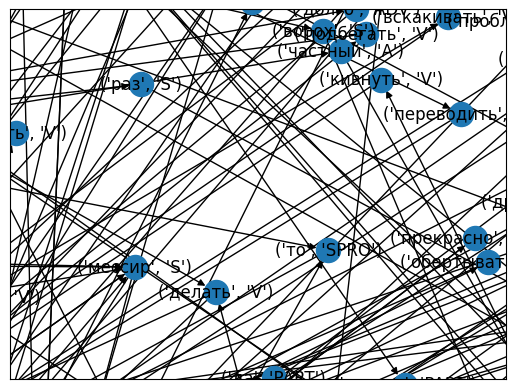

In [ ]:
# New

nx.draw_networkx(df['graph'][1].G)
plt.axis([0.3, 0.7, 0.3, 0.7])

In [ ]:
!pip install dill

Сохраняем на диск

In [ ]:
import dill
with open('graphs_full_mystem_cleaned_5.pkl', 'wb') as f:
    dill.dump(df, f)

# DGL

In [3]:
#upd
# !pip install dill -q
# !pip install dgl -q
# !mkdir save
import dill
import dgl
import torch
import os
from sklearn.model_selection import train_test_split
from gensim.models import Word2Vec
from tqdm.notebook import trange
from sklearn.decomposition import PCA
import plotly.express as px
from sklearn.metrics.pairwise import cosine_similarity
from sklearn.utils.class_weight import compute_class_weight

In [ ]:
del df

In [ ]:
import dill
with open(r'graphs_full_mystem_cleaned_5.pkl', 'rb') as f:
    loaded_df = dill.load(f)
loaded_df

,filename,text,preprocessed_text,graph
0,10857_108456,Я стояла и ошарашенно смотрела на невероятно к...,"[(я, SPRO), (стоять, V), (и, CONJ), (ошарашенн...",<__main__.ToCoocurrence object at 0x7f94d1de0d50>
1,10857_120026,Обычная городская квартира. В не менее посредс...,"[(обычный, A), (городской, A), (квартира, S), ...",<__main__.ToCoocurrence object at 0x7f94d1c735d0>
2,10857_120659,"С момента, когда уставший после операции Браги...","[(с, PR), (момент, S), (,, PUNCT), (когда, CON...",<__main__.ToCoocurrence object at 0x7f94d1af2190>
3,10857_121352,"...Она бежала, неслась изо всех сил, продираяс...","[(., PUNCT), (., PUNCT), (., PUNCT), (она, SPR...",<__main__.ToCoocurrence object at 0x7f94d1a2bb90>
4,10857_127251,"Подожди, дай сделать ещё вдох и попрощаться, м...","[(подождать, V), (,, PUNCT), (давать, V), (сде...",<__main__.ToCoocurrence object at 0x7f94d1a63b50>
...,...,...,...,...
4374,94_9083077,На столе моем стоит в рамочке картинка.\nНа ка...,"[(на, PR), (стол, S), (мой, APRO), (стоять, V)...",<__main__.ToCoocurrence object at 0x7f95016e3f50>
4375,94_9675582,Молчание затягивалось.\nЯ медленно встал с кро...,"[(молчание, S), (затягиваться, V), (., PUNCT),...",<__main__.ToCoocurrence object at 0x7f95015c19d0>
4376,94_9702631,Понедельник\nПроснулся с жуткой головной болью...,"[(понедельник, S), (просыпаться, V), (с, PR), ...",<__main__.ToCoocurrence object at 0x7f9501424250>
4377,94_9735487,\nТьма и золото на плечах невесты.\nСкользит к...,"[(тьма, S), (и, CONJ), (золото, S), (на, PR), ...",<__main__.ToCoocurrence object at 0x7f95014904d0>


In [ ]:
tqdm.pandas(desc='converting graphs', colour='#e87d1a')
loaded_df['author'] = loaded_df['filename'].apply(lambda x: int(x.split('_')[0]))
loaded_df['author'] = pd.factorize(loaded_df['author'])[0]
loaded_df = loaded_df.loc[(loaded_df['author'] != 0) & (loaded_df['author'] != 6) & (loaded_df['author'] != 21)]
loaded_df['author'] = pd.factorize(loaded_df['author'])[0]
loaded_df = loaded_df.loc[loaded_df['author'] != 13]
loaded_df['author'] = pd.factorize(loaded_df['author'])[0]
loaded_df

/tmp/ipykernel_88/3029775328.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  loaded_df['author'] = pd.factorize(loaded_df['author'])[0]


,filename,text,preprocessed_text,graph,author
18,1198828_018a7ba7-6f3b-7e46-b517-cfdc53a4a13a,Давид\n\n\nКак странно иногда находить е...,"[(давид, S), (как, ADVPRO), (странно, ADV), (и...",<__main__.ToCoocurrence object at 0x7f94d16603d0>,0
19,1198828_018b97c5-8f6e-71a5-8ed7-aab2b6d23dc5,"— А мне старуху обещали, — говорит молодец с о...","[(—, PUNCT), (а, CONJ), (я, SPRO), (старуха, S...",<__main__.ToCoocurrence object at 0x7f94d0b476d0>,0
20,1198828_10007147,"— Чего тебе, блядь, надо?\n\nВырывается, даже ...","[(—, PUNCT), (что, SPRO), (ты, SPRO), (,, PUNC...",<__main__.ToCoocurrence object at 0x7f94d0946f90>,0
21,1198828_10241424,"— Старшего брата позови, — требую, пожевывая р...","[(—, PUNCT), (старший, A), (брат, S), (позвать...",<__main__.ToCoocurrence object at 0x7f94d0419f90>,0
22,1198828_10527321,— По пятьдесят рома мне и этому парню. «Капита...,"[(—, PUNCT), (по, PR), (пятьдесят, NUM), (ром,...",<__main__.ToCoocurrence object at 0x7f94d02bdf90>,0
...,...,...,...,...,...
4374,94_9083077,На столе моем стоит в рамочке картинка.\nНа ка...,"[(на, PR), (стол, S), (мой, APRO), (стоять, V)...",<__main__.ToCoocurrence object at 0x7f95016e3f50>,18
4375,94_9675582,Молчание затягивалось.\nЯ медленно встал с кро...,"[(молчание, S), (затягиваться, V), (., PUNCT),...",<__main__.ToCoocurrence object at 0x7f95015c19d0>,18
4376,94_9702631,Понедельник\nПроснулся с жуткой головной болью...,"[(понедельник, S), (просыпаться, V), (с, PR), ...",<__main__.ToCoocurrence object at 0x7f9501424250>,18
4377,94_9735487,\nТьма и золото на плечах невесты.\nСкользит к...,"[(тьма, S), (и, CONJ), (золото, S), (на, PR), ...",<__main__.ToCoocurrence object at 0x7f95014904d0>,18


In [ ]:
i = 0
for text in loaded_df['text']:
    text = text.replace('\n', ' ')
    i += len(text.split())
i

'— А мне старуху обещали, — говорит молодец с огоньком любопытства в больших и зелено-синих, что яхонты, глазах.\n\nОн ступает в сени, дверь без стука распахнув, как к себе домой, когда избушка нехотя поворачивается по его приказу — тоже, вишь, отвыкла от охотников на ту сторону перебраться. Молодец постукивает об порог каблуками сапог сафьяновых и, сняв красную шапку, кланяется в пояс Ягу, а после — каждому углу. Избушка довольно поскрипывает половичками, и Яг чувствует по тому, как кренится под ним пол, что кокетливо поджимает под себя куриную ножку. («Как тебя легко умаслить, деревянная!» — думает Яг с сумрачной досадой.)\n\n— Где ж бабка, девица? — спрашивает молодец, с интересом оглядывая избу. Яг на «девицу» не дивится, чай, сам другого не ждет: всякий обманется, сарафан на ладной фигуре увидав да косу темную в пояс, убранную каменьями. Лицу молодость красы добавляет, так и на голос попенять можно, что в лесу сорвал.\n\n— На покой ушла, — отвечает Яг.\n\n— Светло у тебя девица, п

In [ ]:
diameters = []
for graph in tqdm(loaded_df['graph']):
    try:
        diameters.append(nx.approximation.diameter(graph.G))
    except nx.NetworkXError:
        diameters.append(np.nan)

100%|██████████████████████████████████████████████████████████████████████████████████████████████████████████| 4295/4295 [00:56<00:00, 76.11it/s]


In [ ]:
loaded_df['diameter di'] = diameters
loaded_df.head(2)

,filename,text,preprocessed_text,graph,author,diameter di
18,1198828_018a7ba7-6f3b-7e46-b517-cfdc53a4a13a,Давид\n\n\nКак странно иногда находить е...,"[(давид, S), (как, ADVPRO), (странно, ADV), (и...",<__main__.ToCoocurrence object at 0x7f58ac675d90>,0,9.0
19,1198828_018b97c5-8f6e-71a5-8ed7-aab2b6d23dc5,"— А мне старуху обещали, — говорит молодец с о...","[(—, PUNCT), (а, CONJ), (я, SPRO), (старуха, S...",<__main__.ToCoocurrence object at 0x7f58abb690d0>,0,11.0


In [ ]:
loaded_df['diameter di'].isna().sum()

716

In [ ]:
from statistics import mean
import random
import nx_cugraph as nxcg
import time

test = []
def avg_shortest_paths(graph_):
    G_nx = nx.to_undirected(graph_.G)
    G_nx = nxcg.from_networkx(G_nx)
    for component in nx.connected_components(G_nx):
        component_ = graph_.G.subgraph(component)
        nodes = component_.nodes()
        component_ = nxcg.from_networkx(component_)
        lengths = []
        # for _ in range(graph_.G.number_of_nodes()):
        #     n1, n2 = random.choices(list(nodes), k=2)
        length = nx.shortest_path_length(component_)
        lengths.append(length)
    if not lengths:
        return np.nan
    print(lengths)
    # for i in lengths[0]:
    #     print(len(i[1]))
        # return mean(lengths)

avg_shortest_paths(loaded_df['graph'].iloc[1])
# loaded_df['avg path di'] = loaded_df['graph'].progress_apply(avg_shortest_paths)

/mnt/c/users/1/desktop/karina_diploma/diploma_work_2024/src/lin_note/lib/python3.11/site-packages/cupy/_environment.py:487: UserWarning: 
--------------------------------------------------------------------------------

  CuPy may not function correctly because multiple CuPy packages are installed
  in your environment:

    cupy-cuda11x, cupy-cuda12x

  Follow these steps to resolve this issue:

    1. For all packages listed above, run the following command to remove all
       existing CuPy installations:

         $ pip uninstall <package_name>

      If you previously installed CuPy via conda, also run the following:

         $ conda uninstall cupy

    2. Install the appropriate CuPy package.
       Refer to the Installation Guide for detailed instructions.

         https://docs.cupy.dev/en/stable/install.html

--------------------------------------------------------------------------------

  warnings.warn(f'''


[<generator object all_pairs_shortest_path_length at 0x7f58da614590>]


In [ ]:
loaded_df['num nodes'] = loaded_df['graph'].progress_apply(lambda x: x.G.number_of_nodes())
loaded_df.head(2)

converting graphs: 100%|███████████████████████████████████████████████████████████████████████████████████| 4295/4295 [00:00<00:00, 774885.40it/s]


,filename,text,preprocessed_text,graph,author,diameter di,num nodes
18,1198828_018a7ba7-6f3b-7e46-b517-cfdc53a4a13a,Давид\n\n\nКак странно иногда находить е...,"[(давид, S), (как, ADVPRO), (странно, ADV), (и...",<__main__.ToCoocurrence object at 0x7f58ac675d90>,0,9.0,7066
19,1198828_018b97c5-8f6e-71a5-8ed7-aab2b6d23dc5,"— А мне старуху обещали, — говорит молодец с о...","[(—, PUNCT), (а, CONJ), (я, SPRO), (старуха, S...",<__main__.ToCoocurrence object at 0x7f58abb690d0>,0,11.0,1726


In [ ]:
loaded_df['num edges'] = loaded_df['graph'].progress_apply(lambda x: x.G.number_of_edges())
loaded_df.head(2)

converting graphs: 100%|█████████████████████████████████████████████████████████████████████████████████████| 4295/4295 [00:01<00:00, 3936.71it/s]


,filename,text,preprocessed_text,graph,author,diameter di,num nodes,num edges
18,1198828_018a7ba7-6f3b-7e46-b517-cfdc53a4a13a,Давид\n\n\nКак странно иногда находить е...,"[(давид, S), (как, ADVPRO), (странно, ADV), (и...",<__main__.ToCoocurrence object at 0x7f58ac675d90>,0,9.0,7066,34836
19,1198828_018b97c5-8f6e-71a5-8ed7-aab2b6d23dc5,"— А мне старуху обещали, — говорит молодец с о...","[(—, PUNCT), (а, CONJ), (я, SPRO), (старуха, S...",<__main__.ToCoocurrence object at 0x7f58abb690d0>,0,11.0,1726,5233


In [ ]:
with open('cooccurence_graphs_with_meta.pkl', 'wb') as f:
    dill.dump(loaded_df, f)

In [ ]:
loaded_df.to_csv('look_for_mean.csv', encoding='utf-8', index=False)

In [ ]:
loaded_df.iloc[48]

filename                                                   36163_89645
text                 - А твой молодой человек совсем тебя не ценит....
preprocessed_text    [(-, PUNCT), (а, CONJ), (твой, APRO), (молодой...
graph                <__main__.ToCoocurrence object at 0x0000025588...
Name: 48, dtype: object

In [ ]:
# new
texts = loaded_df['preprocessed_text'].apply(lambda text: [token[0] for token in text])
w2v = Word2Vec(texts, vector_size=16, min_count=1, window=5, seed=42, workers=1, sg=1, negative=5, epochs=5)

In [ ]:
# new
vocab = w2v.wv.index_to_key
X = w2v.wv[vocab]

In [ ]:
# new
pca = PCA(2, random_state=42)
X_transformed = pca.fit_transform(X)

In [ ]:
# new
vecs_df = pd.DataFrame(X_transformed, index=vocab, columns=['x', 'y'])

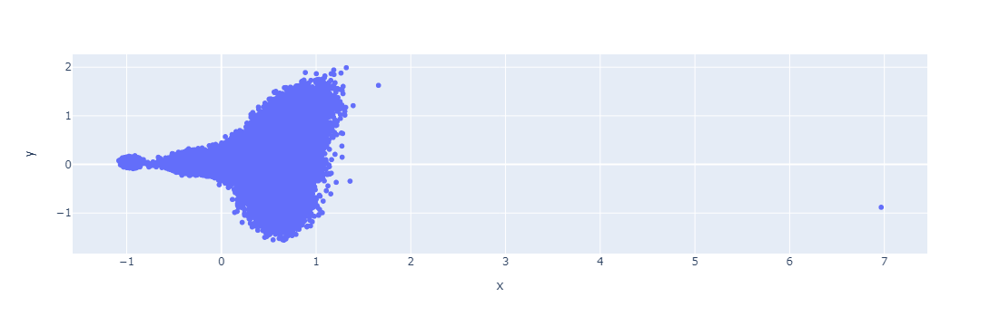

In [ ]:
# new
fig = px.scatter(vecs_df, x='x', y='y', hover_name=vecs_df.index)
fig.show()

In [ ]:
#new
w2v.wv['королева']

array([-0.7235477 ,  0.3473451 ,  0.4142379 ,  0.20660861,  0.16088493,
        0.34703317, -0.7202446 ,  0.25239423,  0.22622298,  0.64592004,
       -0.26839152,  0.711567  ,  0.60740244,  1.1704726 , -0.06652477,
        0.9006834 ], dtype=float32)

In [ ]:
#new
cosine_similarity([w2v.wv['король'] - w2v.wv['мужчина'] + w2v.wv['женщина']], [w2v.wv['королева']])

array([[0.9636998]], dtype=float32)

Класс для хранения и обработки датасета. С диска подгружаем датафрейм, затем обрабатываем, создаём для каждой ноды ohe + word2vec вектора, переводим в формат dgl и локально сохраняем

In [64]:
#upd

from dgl.data import DGLDataset

class GraphDataset(DGLDataset):
  def __init__(self, raw_dir='raw_data', save_dir='./save', verbose=True):
    self._data = None
    self._tags = None
    super().__init__(name='graph_dataset', raw_dir=raw_dir, save_dir=save_dir, verbose=verbose)

  def download(self):
    with open(self.raw_dir + 'graphs_full_mystem_cleaned_5.pkl', 'rb') as f:
      self._data = dill.load(f)

  def process(self):
    self._tags = self._get_taglist()
    self._vectorize()

    tqdm.pandas(desc='converting graphs', colour='#e87d1a')
    self._data['graph'] = self._data['graph'].progress_apply(lambda x: dgl.from_networkx(x.G, node_attrs=['vec']))
    self._data['author'] = self._data['filename'].apply(lambda x: int(x.split('_')[0]))
    self._data['author'] = pd.factorize(self._data['author'])[0]
    self._data = self._data[['preprocessed_text', 'graph', 'author']]

  def save(self):
    with open(f'{self.save_dir}/{self.name}.pkl', 'wb') as f:
      dill.dump(self._data, f)

  def load(self):
    with open(f'{self.save_dir}/{self.name}.pkl', 'rb') as f:
      self._data = dill.load(f)
    self._data = self._data.loc[(self._data['author'] != 0) & (self._data['author'] != 6) & (self._data['author'] != 21)]
    self._data['author'] = pd.factorize(self._data['author'])[0]
    self._data = self._data.loc[self._data['author'] != 13]
    self._data['author'] = pd.factorize(self._data['author'])[0]

  def has_cache(self):
    return os.path.exists(f'{self.save_dir}/{self.name}.pkl')

  def _get_taglist(self):
    tags = []
    for graph in self._data['graph']:
      for node in graph.G.nodes:
        tags.append(node[1])
    return tuple(set(tags))

  def _vectorize(self):
    w2v_vectors = self._make_w2v()
    for graph in tqdm(self._data['graph']):
      for node in tuple(graph.G.nodes):
        ohe = self._make_ohe(node)
        w2v = w2v_vectors[node[0]]
        graph.G.nodes[node]['vec'] = ohe + list(w2v)

  def _make_ohe(self, node):
    # class_tp = ('A', 'ADV', 'ADVPRO', 'ANUM', 'APRO', 'COM', 'CONJ', 'INTJ', 'NUM', 'PART', 'PR', 'S', 'SPRO', 'V', 'ENG', 'PUNCT', 'UNK')
    vec = [0] * len(self._tags)
    vec[self._tags.index(node[1])] = 1
    # graph.G.nodes[pair]['ohe'] = vec
    return vec

  def _make_w2v(self):
    texts = self._data['preprocessed_text'].apply(lambda text: [token[0] for token in text])
    w2v = Word2Vec(texts, vector_size=16, min_count=1, window=5, seed=42, workers=3, sg=1, negative=5, epochs=5) #hs=1 for big vocab
    return w2v.wv

  def __len__(self):
    return len(self._data)

  def __getitem__(self, ind):
    return self._data['graph'].iloc[ind], torch.tensor(self._data['author'].iloc[ind])

In [65]:
graph_dataset = GraphDataset(raw_dir=r'')

Done loading data from cached files.


In [66]:
authors = graph_dataset._data.value_counts('author')
authors

author
10    857
17    641
7     421
15    315
1     240
4     213
6     203
9     202
14    165
16    149
5     146
8     136
12    125
11    114
2      93
3      79
13     67
18     65
0      64
Name: count, dtype: int64

In [ ]:
len(graph_dataset._data)

4295

In [ ]:
from random import choice

def random_gen(n_authors_to_generate):
    excl = []
    rand_authors = []
    for i in range(n_authors_to_generate):
        rand_author = choice([i for i in range(len(authors)) if i not in excl])
        excl.append(rand_author)
        rand_authors.append(rand_author)
    return rand_authors

# graph_dataset._data = graph_dataset._data.loc[~graph_dataset._data['author'].isin([i for i in authors.index if authors[i] < 100])]
# graph_dataset._data = graph_dataset._data.loc[graph_dataset._data['author'].isin([i for i in authors.index[-3:]])]
# graph_dataset._data = graph_dataset._data.loc[graph_dataset._data['author'].isin([i for i in authors.index[:3]])]

# random_authors = random_gen(3)
# graph_dataset._data = graph_dataset._data.loc[graph_dataset._data['author'].isin([i for i in random_authors])]

graph_dataset._data = graph_dataset._data.loc[graph_dataset._data['author'].isin([i for i in [7, 16, 5]])]

graph_dataset._data['author'] = pd.factorize(graph_dataset._data['author'])[0]

In [ ]:
authors = graph_dataset._data.value_counts('author')
authors

author
1    421
2    149
0    146
Name: count, dtype: int64

In [ ]:
graph_dataset._data

,preprocessed_text,graph,author
727,"[(if, ENG), (you, ENG), (’, PUNCT), (re, ENG),...","Graph(num_nodes=3280, num_edges=11054,\n ...",0
728,"[(take, ENG), (a, ENG), (look, ENG), (around, ...","Graph(num_nodes=5012, num_edges=20023,\n ...",0
729,"[(меч, S), (в, PR), (рука, S), (моргауз, S), (...","Graph(num_nodes=171, num_edges=294,\n nda...",0
730,"[(команда, S), («, PUNCT), (серенити, S), (», ...","Graph(num_nodes=743, num_edges=1620,\n nd...",0
731,"[(*, PUNCT), (snag, ENG), (—, PUNCT), (партнер...","Graph(num_nodes=6878, num_edges=31236,\n ...",0
...,...,...,...
2926,"[(., PUNCT), (., PUNCT), (., PUNCT), (море, S)...","Graph(num_nodes=126, num_edges=241,\n nda...",2
2927,"[(однажды, ADV), (утро, S), (бог, S), (просыпа...","Graph(num_nodes=2408, num_edges=8328,\n n...",2
2928,"[(в, PR), (аудитория, S), (не, PART), (быть, V...","Graph(num_nodes=189, num_edges=328,\n nda...",2
2929,"[(–, PUNCT), (зачем, ADVPRO), (ты, SPRO), (это...","Graph(num_nodes=224, num_edges=405,\n nda...",2


Разделяем датасет на три выборки: тренировочную, валидационную и тестовую

In [ ]:
from dgl.data.utils import split_dataset

split = split_dataset(graph_dataset, frac_list=[0.7, 0.1, 0.2], shuffle=True, random_state=42)
split

## Model Definition

Модель из туториала

In [ ]:
import dgl.nn.pytorch as dglnn
import torch.nn as nn
import torch.nn.functional as F

class Classifier(nn.Module):
    def __init__(self, in_dim, hidden_dim, n_classes):
        super(Classifier, self).__init__()
        self.conv1 = dglnn.GraphConv(in_dim, hidden_dim)
        self.conv2 = dglnn.GraphConv(hidden_dim, hidden_dim)
        self.conv3 = dglnn.GraphConv(hidden_dim, hidden_dim)
        # self.conv4 = dglnn.GraphConv(hidden_dim, hidden_dim)
        self.classify = nn.Linear(hidden_dim, n_classes)

    def forward(self, g, h):
        # Apply graph convolution and activation.
        with g.local_scope():
          num_nodes = g.batch_num_nodes()
          num_edges = g.batch_num_edges()
          g = dgl.add_self_loop(g)
          g.set_batch_num_nodes(num_nodes)
          g.set_batch_num_edges(num_edges)
        h = F.relu(self.conv1(g, h))
        h = F.relu(self.conv2(g, h))
        h = F.relu(self.conv3(g, h))
        # print(h.shape)
        # print(h)
        # h = F.relu(self.conv4(g, h))
        with g.local_scope():
            g.ndata['h'] = h
            # Calculate graph representation by average readout.
            hg = dgl.mean_nodes(g, 'h')
            return self.classify(hg)

Даталоадер для всех трёх выборок

In [ ]:
#upd

from dgl.dataloading import GraphDataLoader
batch_size = 32
train_dataloader = GraphDataLoader(
    split[0],
    batch_size=batch_size,
    drop_last=False,
    shuffle=True,
)
val_dataloader = GraphDataLoader(
    split[1],
    batch_size=batch_size,
    drop_last=False,
    shuffle=False)
test_dataloader = GraphDataLoader(
    split[2],
    batch_size=batch_size,
    drop_last=False,
    shuffle=False)

In [ ]:
#new
classes = []
for y in train_dataloader:
  classes.extend(y[1].numpy().astype(np.int64))

In [ ]:
#new
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

class_weights = compute_class_weight(class_weight='balanced', classes=np.unique(classes), y=classes)
class_weights = torch.Tensor(class_weights)
class_weights = class_weights.to(device)
class_weights

tensor([1.5607, 0.5799, 1.5755], device='cuda:0')

In [ ]:
class_weights.size()[0]

3

# Baseline (doc2vec + Logistic Regression) (19 авторов)

In [ ]:
from sklearn.metrics import classification_report

model = Classifier(33, 40, class_weights.size()[0])

with torch.no_grad():
  y_pred = []
  labels = []
  for batched_graph, label in test_dataloader:
    logits = model(batched_graph, batched_graph.ndata['vec'])
    for logit in logits:
      y_pred.append(torch.argmax(logit))
    # print(y_pred)
    labels.extend(label)
    # print(labels)
print(classification_report(labels, y_pred))

              precision    recall  f1-score   support

           0       0.00      0.00      0.00        13
           1       0.00      0.00      0.00        44
           2       0.00      0.00      0.00        14
           3       0.00      0.00      0.00        16
           4       0.00      0.00      0.00        44
           5       0.00      0.00      0.00        30
           6       0.00      0.00      0.00        45
           7       0.09      1.00      0.17        78
           8       0.00      0.00      0.00        27
           9       0.00      0.00      0.00        42
          10       0.00      0.00      0.00       147
          11       0.00      0.00      0.00        24
          12       0.00      0.00      0.00        31
          13       0.00      0.00      0.00        16
          14       0.00      0.00      0.00        41
          15       0.00      0.00      0.00        70
          16       0.00      0.00      0.00        33
          17       0.00    

/mnt/c/users/1/desktop/karina_diploma/diploma_work_2024/src/lin_note/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/mnt/c/users/1/desktop/karina_diploma/diploma_work_2024/src/lin_note/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/mnt/c/users/1/desktop/karina_diploma/diploma_work_2024/src/lin_note/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use 

Обучение на 200 эпохах. Обучение происходит на тренировочной выборке + считается loss на валидационной

In [67]:
from gensim.models.doc2vec import Doc2Vec, TaggedDocument

texts = graph_dataset._data['preprocessed_text'].apply(lambda text: [token[0] for token in text])
tagged_corpus = [TaggedDocument(words=text, tags=[str(i)]) for i, text in enumerate(texts.to_list())]

In [68]:
d2v = Doc2Vec(vector_size=33, min_count=1, epochs=50, seed=42)

In [69]:
d2v.build_vocab(tagged_corpus)

In [70]:
d2v.train(tagged_corpus, total_examples=d2v.corpus_count, epochs=d2v.epochs)

In [71]:
document_vectors = [d2v.infer_vector(text) for text in texts]

In [72]:
graph_dataset._data['vector'] = document_vectors

In [73]:
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split

x_train, x_test, y_train, y_test = train_test_split(graph_dataset._data['vector'], graph_dataset._data['author'], random_state=42)
print(x_train.shape, x_test.shape, y_train.shape, y_test.shape)

(3221,) (1074,) (3221,) (1074,)


In [74]:
clf = LogisticRegression(random_state=42)
clf.fit(np.array(x_train.to_list()), y_train)

/mnt/c/users/1/desktop/karina_diploma/diploma_work_2024/src/lin_note/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:469: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


LogisticRegression(random_state=42)

In [75]:
from sklearn.metrics import classification_report

print(classification_report(y_test, clf.predict(np.array(x_test.to_list()))))

              precision    recall  f1-score   support

           0       0.94      0.85      0.89        20
           1       0.79      0.67      0.72        69
           2       0.91      0.91      0.91        22
           3       1.00      0.88      0.94        26
           4       0.86      0.88      0.87        49
           5       0.74      0.74      0.74        39
           6       0.93      0.89      0.91        46
           7       0.87      0.85      0.86       124
           8       0.87      0.82      0.85        40
           9       0.96      0.94      0.95        51
          10       0.94      0.97      0.95       211
          11       0.68      0.71      0.69        24
          12       0.77      0.68      0.72        25
          13       0.59      0.71      0.65        14
          14       0.85      0.94      0.89        35
          15       0.84      0.83      0.83        81
          16       0.84      0.86      0.85        43
          17       0.90    

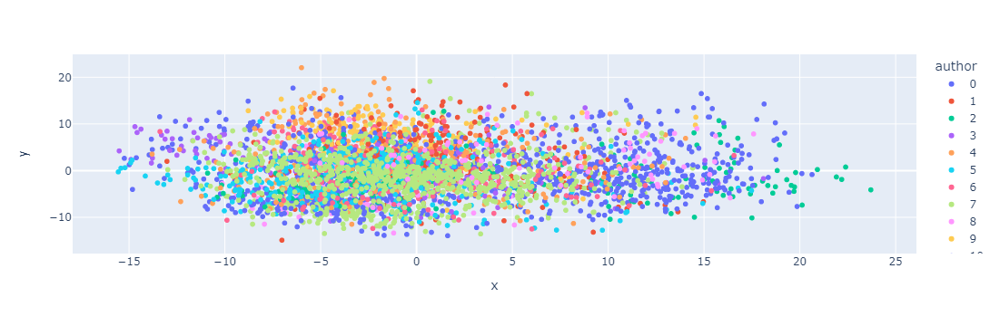

In [76]:
pca = PCA(n_components=2, random_state=42)
d2 = pca.fit_transform(np.asarray(graph_dataset._data['vector'].apply(lambda x: x.tolist()).to_list()))
test_vec_df = pd.DataFrame({'x': d2[:, 0], 'y': d2[:, 1], 'author': graph_dataset._data['author'].apply(lambda x: str(x))})
fig = px.scatter(test_vec_df, x='x', y='y', color='author', hover_data='author')
fig.show()

# doc2vec + baseline (14 авторов)

In [ ]:
from sklearn.metrics import classification_report

model = Classifier(33, 40, class_weights.size()[0])

with torch.no_grad():
  y_pred = []
  labels = []
  for batched_graph, label in test_dataloader:
    logits = model(batched_graph, batched_graph.ndata['vec'])
    for logit in logits:
      y_pred.append(torch.argmax(logit))
    # print(y_pred)
    labels.extend(label)
    # print(labels)
print(classification_report(labels, y_pred))

              precision    recall  f1-score   support

           0       0.00      0.00      0.00        44
           1       0.00      0.00      0.00        29
           2       0.00      0.00      0.00        27
           3       0.00      0.00      0.00        46
           4       0.12      1.00      0.22        96
           5       0.00      0.00      0.00        19
           6       0.00      0.00      0.00        41
           7       0.00      0.00      0.00       158
           8       0.00      0.00      0.00        23
           9       0.00      0.00      0.00        23
          10       0.00      0.00      0.00        36
          11       0.00      0.00      0.00        74
          12       0.00      0.00      0.00        28
          13       0.00      0.00      0.00       143

    accuracy                           0.12       787
   macro avg       0.01      0.07      0.02       787
weighted avg       0.01      0.12      0.03       787


/mnt/c/users/1/desktop/karina_diploma/diploma_work_2024/src/lin_note/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

/mnt/c/users/1/desktop/karina_diploma/diploma_work_2024/src/lin_note/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

/mnt/c/users/1/desktop/karina_diploma/diploma_work_2024/src/lin_note/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



In [ ]:
from gensim.models.doc2vec import Doc2Vec, TaggedDocument

texts = graph_dataset._data['preprocessed_text'].apply(lambda text: [token[0] for token in text])
tagged_corpus = [TaggedDocument(words=text, tags=[str(i)]) for i, text in enumerate(texts.to_list())]

In [ ]:
d2v = Doc2Vec(vector_size=33, min_count=1, epochs=50, seed=42)

In [ ]:
d2v.build_vocab(tagged_corpus)

In [ ]:
d2v.train(tagged_corpus, total_examples=d2v.corpus_count, epochs=d2v.epochs)

In [ ]:
document_vectors = [d2v.infer_vector(text) for text in texts]

In [ ]:
graph_dataset._data['vector'] = document_vectors

In [ ]:
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split

x_train, x_test, y_train, y_test = train_test_split(graph_dataset._data['vector'], graph_dataset._data['author'], random_state=42)
print(x_train.shape, x_test.shape, y_train.shape, y_test.shape)

(2945,) (982,) (2945,) (982,)


In [ ]:
clf = LogisticRegression(random_state=42)
clf.fit(np.array(x_train.to_list()), y_train)

/mnt/c/users/1/desktop/karina_diploma/diploma_work_2024/src/lin_note/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:469: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression



LogisticRegression(random_state=42)

In [ ]:
from sklearn.metrics import classification_report

print(classification_report(y_test, clf.predict(np.array(x_test.to_list()))))

              precision    recall  f1-score   support

           0       0.77      0.76      0.77        72
           1       0.95      0.91      0.93        65
           2       0.71      0.58      0.64        38
           3       0.88      0.95      0.91        44
           4       0.92      0.93      0.92       108
           5       0.79      0.79      0.79        29
           6       0.92      0.93      0.92        58
           7       0.96      0.94      0.95       209
           8       0.92      0.85      0.88        27
           9       0.68      0.83      0.75        23
          10       0.74      0.86      0.80        43
          11       0.81      0.84      0.83        62
          12       0.83      0.86      0.85        35
          13       0.92      0.90      0.91       169

    accuracy                           0.88       982
   macro avg       0.84      0.85      0.85       982
weighted avg       0.88      0.88      0.88       982


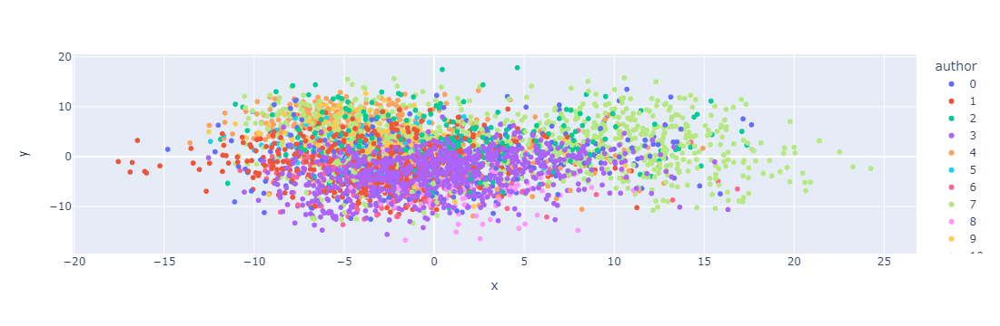

In [ ]:
pca = PCA(n_components=2, random_state=42)
d2 = pca.fit_transform(np.asarray(graph_dataset._data['vector'].apply(lambda x: x.tolist()).to_list()))
test_vec_df = pd.DataFrame({'x': d2[:, 0], 'y': d2[:, 1], 'author': graph_dataset._data['author'].apply(lambda x: str(x))})
fig = px.scatter(test_vec_df, x='x', y='y', color='author', hover_data='author')
fig.show()

# doc2vec + baseline (3 самых маленьких автора)

In [ ]:
from sklearn.metrics import classification_report

model = Classifier(33, 40, class_weights.size()[0])

with torch.no_grad():
  y_pred = []
  labels = []
  for batched_graph, label in test_dataloader:
    logits = model(batched_graph, batched_graph.ndata['vec'])
    for logit in logits:
      y_pred.append(torch.argmax(logit))
    # print(y_pred)
    labels.extend(label)
    # print(labels)
print(classification_report(labels, y_pred))

              precision    recall  f1-score   support

           0       0.67      0.33      0.44        12
           1       0.00      0.00      0.00        14
           2       0.41      1.00      0.58        14

    accuracy                           0.45        40
   macro avg       0.36      0.44      0.34        40
weighted avg       0.34      0.45      0.34        40


/mnt/c/users/1/desktop/karina_diploma/diploma_work_2024/src/lin_note/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

/mnt/c/users/1/desktop/karina_diploma/diploma_work_2024/src/lin_note/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

/mnt/c/users/1/desktop/karina_diploma/diploma_work_2024/src/lin_note/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



In [ ]:
from gensim.models.doc2vec import Doc2Vec, TaggedDocument

texts = graph_dataset._data['preprocessed_text'].apply(lambda text: [token[0] for token in text])
tagged_corpus = [TaggedDocument(words=text, tags=[str(i)]) for i, text in enumerate(texts.to_list())]

In [ ]:
d2v = Doc2Vec(vector_size=33, min_count=1, epochs=50, seed=42)

In [ ]:
d2v.build_vocab(tagged_corpus)

In [ ]:
d2v.train(tagged_corpus, total_examples=d2v.corpus_count, epochs=d2v.epochs)

In [ ]:
document_vectors = [d2v.infer_vector(text) for text in texts]

In [ ]:
graph_dataset._data['vector'] = document_vectors

In [ ]:
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split

x_train, x_test, y_train, y_test = train_test_split(graph_dataset._data['vector'], graph_dataset._data['author'], random_state=42)
print(x_train.shape, x_test.shape, y_train.shape, y_test.shape)

(147,) (49,) (147,) (49,)


In [ ]:
clf = LogisticRegression(random_state=42)
clf.fit(np.array(x_train.to_list()), y_train)

LogisticRegression(random_state=42)

In [ ]:
from sklearn.metrics import classification_report

print(classification_report(y_test, clf.predict(np.array(x_test.to_list()))))

              precision    recall  f1-score   support

           0       1.00      1.00      1.00        14
           1       1.00      1.00      1.00        20
           2       1.00      1.00      1.00        15

    accuracy                           1.00        49
   macro avg       1.00      1.00      1.00        49
weighted avg       1.00      1.00      1.00        49


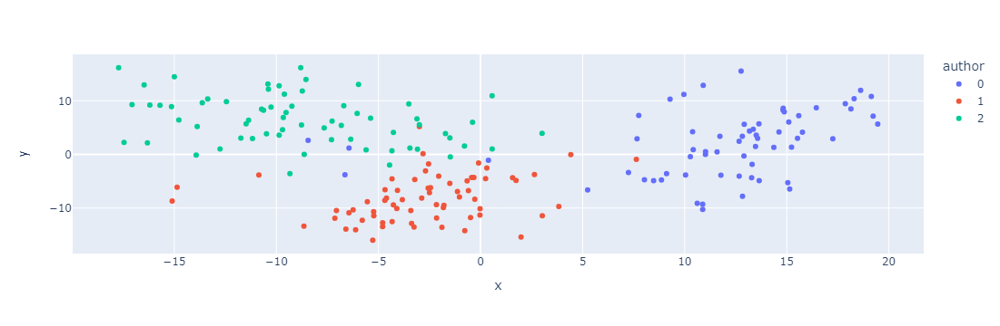

In [ ]:
pca = PCA(n_components=2, random_state=42)
d2 = pca.fit_transform(np.asarray(graph_dataset._data['vector'].apply(lambda x: x.tolist()).to_list()))
test_vec_df = pd.DataFrame({'x': d2[:, 0], 'y': d2[:, 1], 'author': graph_dataset._data['author'].apply(lambda x: str(x))})
fig = px.scatter(test_vec_df, x='x', y='y', color='author', hover_data='author')
fig.show()

# doc2vec + baseline (3 самых больших автора)

In [ ]:
from sklearn.metrics import classification_report

model = Classifier(33, 40, class_weights.size()[0])

with torch.no_grad():
  y_pred = []
  labels = []
  for batched_graph, label in test_dataloader:
    logits = model(batched_graph, batched_graph.ndata['vec'])
    for logit in logits:
      y_pred.append(torch.argmax(logit))
    # print(y_pred)
    labels.extend(label)
    # print(labels)
print(classification_report(labels, y_pred))

              precision    recall  f1-score   support

           0       0.00      0.00      0.00        77
           1       0.43      1.00      0.60       164
           2       0.00      0.00      0.00       144

    accuracy                           0.43       385
   macro avg       0.14      0.33      0.20       385
weighted avg       0.18      0.43      0.25       385


/mnt/c/users/1/desktop/karina_diploma/diploma_work_2024/src/lin_note/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

/mnt/c/users/1/desktop/karina_diploma/diploma_work_2024/src/lin_note/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

/mnt/c/users/1/desktop/karina_diploma/diploma_work_2024/src/lin_note/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



In [ ]:
from gensim.models.doc2vec import Doc2Vec, TaggedDocument

texts = graph_dataset._data['preprocessed_text'].apply(lambda text: [token[0] for token in text])
tagged_corpus = [TaggedDocument(words=text, tags=[str(i)]) for i, text in enumerate(texts.to_list())]

In [ ]:
d2v = Doc2Vec(vector_size=33, min_count=1, epochs=50, seed=42)

In [ ]:
d2v.build_vocab(tagged_corpus)

In [ ]:
d2v.train(tagged_corpus, total_examples=d2v.corpus_count, epochs=d2v.epochs)

In [ ]:
document_vectors = [d2v.infer_vector(text) for text in texts]

In [ ]:
graph_dataset._data['vector'] = document_vectors

In [ ]:
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split

x_train, x_test, y_train, y_test = train_test_split(graph_dataset._data['vector'], graph_dataset._data['author'], random_state=42)
print(x_train.shape, x_test.shape, y_train.shape, y_test.shape)

(1439,) (480,) (1439,) (480,)


In [ ]:
clf = LogisticRegression(random_state=42)
clf.fit(np.array(x_train.to_list()), y_train)

LogisticRegression(random_state=42)

In [ ]:
from sklearn.metrics import classification_report

print(classification_report(y_test, clf.predict(np.array(x_test.to_list()))))

              precision    recall  f1-score   support

           0       1.00      0.99      1.00       106
           1       1.00      1.00      1.00       209
           2       0.99      0.99      0.99       165

    accuracy                           1.00       480
   macro avg       1.00      0.99      1.00       480
weighted avg       1.00      1.00      1.00       480


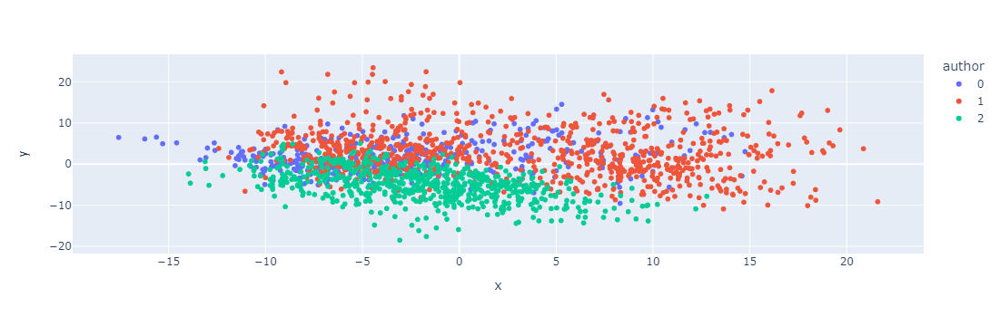

In [ ]:
pca = PCA(n_components=2, random_state=42)
d2 = pca.fit_transform(np.asarray(graph_dataset._data['vector'].apply(lambda x: x.tolist()).to_list()))
test_vec_df = pd.DataFrame({'x': d2[:, 0], 'y': d2[:, 1], 'author': graph_dataset._data['author'].apply(lambda x: str(x))})
fig = px.scatter(test_vec_df, x='x', y='y', color='author', hover_data='author')
fig.show()

# doc2vec + baseline (3 случайных автора)

In [ ]:
from sklearn.metrics import classification_report

model = Classifier(33, 40, class_weights.size()[0])

with torch.no_grad():
  y_pred = []
  labels = []
  for batched_graph, label in test_dataloader:
    logits = model(batched_graph, batched_graph.ndata['vec'])
    for logit in logits:
      y_pred.append(torch.argmax(logit))
    # print(y_pred)
    labels.extend(label)
    # print(labels)
print(classification_report(labels, y_pred))

              precision    recall  f1-score   support

           0       0.00      0.00      0.00        32
           1       0.60      1.00      0.75        87
           2       0.00      0.00      0.00        25

    accuracy                           0.60       144
   macro avg       0.20      0.33      0.25       144
weighted avg       0.37      0.60      0.46       144


/mnt/c/users/1/desktop/karina_diploma/diploma_work_2024/src/lin_note/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

/mnt/c/users/1/desktop/karina_diploma/diploma_work_2024/src/lin_note/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.

/mnt/c/users/1/desktop/karina_diploma/diploma_work_2024/src/lin_note/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning:

Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.



In [ ]:
from gensim.models.doc2vec import Doc2Vec, TaggedDocument

texts = graph_dataset._data['preprocessed_text'].apply(lambda text: [token[0] for token in text])
tagged_corpus = [TaggedDocument(words=text, tags=[str(i)]) for i, text in enumerate(texts.to_list())]

In [ ]:
d2v = Doc2Vec(vector_size=33, min_count=1, epochs=50, seed=42)

In [ ]:
d2v.build_vocab(tagged_corpus)

In [ ]:
d2v.train(tagged_corpus, total_examples=d2v.corpus_count, epochs=d2v.epochs)

In [ ]:
document_vectors = [d2v.infer_vector(text) for text in texts]

In [ ]:
graph_dataset._data['vector'] = document_vectors

In [ ]:
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split

x_train, x_test, y_train, y_test = train_test_split(graph_dataset._data['vector'], graph_dataset._data['author'], random_state=42)
print(x_train.shape, x_test.shape, y_train.shape, y_test.shape)

(537,) (179,) (537,) (179,)


In [ ]:
clf = LogisticRegression(random_state=42)
clf.fit(np.array(x_train.to_list()), y_train)

LogisticRegression(random_state=42)

In [ ]:
from sklearn.metrics import classification_report

print(classification_report(y_test, clf.predict(np.array(x_test.to_list()))))

              precision    recall  f1-score   support

           0       1.00      1.00      1.00        44
           1       0.99      0.97      0.98        98
           2       0.92      0.97      0.95        37

    accuracy                           0.98       179
   macro avg       0.97      0.98      0.98       179
weighted avg       0.98      0.98      0.98       179


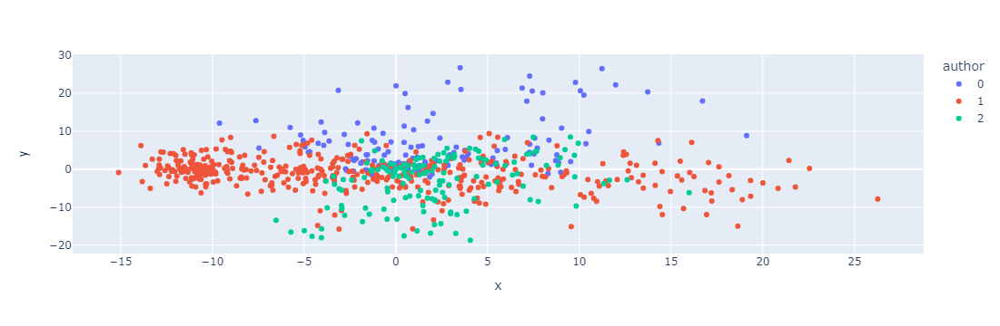

In [ ]:
pca = PCA(n_components=2, random_state=42)
d2 = pca.fit_transform(np.asarray(graph_dataset._data['vector'].apply(lambda x: x.tolist()).to_list()))
test_vec_df = pd.DataFrame({'x': d2[:, 0], 'y': d2[:, 1], 'author': graph_dataset._data['author'].apply(lambda x: str(x))})
fig = px.scatter(test_vec_df, x='x', y='y', color='author', hover_data='author')
fig.show()

# LogReg (19 авторов)

In [ ]:
dgl_df = graph_dataset._data
# высчитываем среднее значение векторов для каждого графа
dgl_df['mean_vector'] = dgl_df['graph'].apply(lambda x: [tens.item() for tens in dgl.mean_nodes(x, 'vec').squeeze(0)])
dgl_df.head()

,preprocessed_text,graph,author,mean_vector
18,"[(давид, S), (как, ADVPRO), (странно, ADV), (и...","Graph(num_nodes=7066, num_edges=34836,\n ...",0,"[0.003821115242317319, 0.0022643646225333214, ..."
19,"[(—, PUNCT), (а, CONJ), (я, SPRO), (старуха, S...","Graph(num_nodes=1726, num_edges=5233,\n n...",0,"[0.010428736917674541, 0.0034762455616146326, ..."
20,"[(—, PUNCT), (что, SPRO), (ты, SPRO), (,, PUNC...","Graph(num_nodes=3839, num_edges=13649,\n ...",0,"[0.005991143640130758, 0.003907267469912767, 0..."
21,"[(—, PUNCT), (старший, A), (брат, S), (позвать...","Graph(num_nodes=2282, num_edges=7164,\n n...",0,"[0.008326029404997826, 0.005258545279502869, 0..."
22,"[(—, PUNCT), (по, PR), (пятьдесят, NUM), (ром,...","Graph(num_nodes=6183, num_edges=28705,\n ...",0,"[0.0043668122962117195, 0.0037198769859969616,..."


In [ ]:
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split

x_train, x_test, y_train, y_test = train_test_split(dgl_df['mean_vector'], dgl_df['author'], random_state=42)
print(x_train.shape, x_test.shape, y_train.shape, y_test.shape)

(3221,) (1074,) (3221,) (1074,)


In [ ]:
clf = LogisticRegression(random_state=42)
clf.fit(np.array(x_train.to_list()), y_train)

/mnt/c/users/1/desktop/karina_diploma/diploma_work_2024/src/lin_note/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:469: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


LogisticRegression(random_state=42)

In [ ]:
from sklearn.metrics import classification_report
print(classification_report(y_test, clf.predict(np.array(x_test.to_list()))))

              precision    recall  f1-score   support

           0       0.00      0.00      0.00        20
           1       0.24      0.17      0.20        69
           2       0.75      0.14      0.23        22
           3       1.00      0.08      0.14        26
           4       0.39      0.51      0.44        49
           5       0.00      0.00      0.00        39
           6       0.50      0.41      0.45        46
           7       0.57      0.31      0.41       124
           8       0.00      0.00      0.00        40
           9       0.73      0.69      0.71        51
          10       0.37      0.87      0.52       211
          11       0.00      0.00      0.00        24
          12       0.00      0.00      0.00        25
          13       0.00      0.00      0.00        14
          14       0.50      0.06      0.10        35
          15       0.51      0.26      0.34        81
          16       0.60      0.07      0.12        43
          17       0.47    

/mnt/c/users/1/desktop/karina_diploma/diploma_work_2024/src/lin_note/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/mnt/c/users/1/desktop/karina_diploma/diploma_work_2024/src/lin_note/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/mnt/c/users/1/desktop/karina_diploma/diploma_work_2024/src/lin_note/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use 

# LogReg (14 авторов)

In [ ]:
dgl_df = graph_dataset._data
# высчитываем среднее значение векторов для каждого графа
dgl_df['mean_vector'] = dgl_df['graph'].apply(lambda x: [tens.item() for tens in dgl.mean_nodes(x, 'vec').squeeze(0)])
dgl_df.head()

,preprocessed_text,graph,author,mean_vector
82,"[(то, SPRO), (,, PUNCT), (что, CONJ), (тельфи,...","Graph(num_nodes=10224, num_edges=65313,\n ...",0,"[0.0034233175683766603, 0.002934272401034832, ..."
83,"[(наверняка, ADV), (,, PUNCT), (первый, ANUM),...","Graph(num_nodes=2094, num_edges=6010,\n n...",0,"[0.011461318470537663, 0.0014326648088172078, ..."
84,"[(данте, S), (недовольно, ADV), (морщиться, V)...","Graph(num_nodes=450, num_edges=927,\n nda...",0,"[0.02666666731238365, 0.002222222276031971, 0...."
85,"[(данте, S), (играть, V), (в, PR), (покер, S),...","Graph(num_nodes=290, num_edges=535,\n nda...",0,"[0.03448275849223137, 0.003448275849223137, 0...."
86,"[(петти, S), (и, CONJ), (данте, S), (знать, V)...","Graph(num_nodes=218, num_edges=367,\n nda...",0,"[0.013761468231678009, 0.0, 0.0137614682316780..."


In [ ]:
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split

x_train, x_test, y_train, y_test = train_test_split(dgl_df['mean_vector'], dgl_df['author'], random_state=42)
print(x_train.shape, x_test.shape, y_train.shape, y_test.shape)

(2945,) (982,) (2945,) (982,)


In [ ]:
clf = LogisticRegression(random_state=42)
clf.fit(np.array(x_train.to_list()), y_train)

/mnt/c/users/1/desktop/karina_diploma/diploma_work_2024/src/lin_note/lib/python3.11/site-packages/sklearn/linear_model/_logistic.py:469: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


LogisticRegression(random_state=42)

In [ ]:
from sklearn.metrics import classification_report
print(classification_report(y_test, clf.predict(np.array(x_test.to_list()))))

/mnt/c/users/1/desktop/karina_diploma/diploma_work_2024/src/lin_note/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/mnt/c/users/1/desktop/karina_diploma/diploma_work_2024/src/lin_note/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


              precision    recall  f1-score   support

           0       0.58      0.15      0.24        72
           1       0.70      0.46      0.56        65
           2       0.00      0.00      0.00        38
           3       0.73      0.55      0.62        44
           4       0.59      0.37      0.45       108
           5       0.00      0.00      0.00        29
           6       0.69      0.64      0.66        58
           7       0.42      0.90      0.57       209
           8       0.00      0.00      0.00        27
           9       0.00      0.00      0.00        23
          10       0.40      0.05      0.08        43
          11       0.35      0.27      0.31        62
          12       0.33      0.11      0.17        35
          13       0.56      0.83      0.67       169

    accuracy                           0.50       982
   macro avg       0.38      0.31      0.31       982
weighted avg       0.46      0.50      0.44       982


/mnt/c/users/1/desktop/karina_diploma/diploma_work_2024/src/lin_note/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


# LogReg (3 самых больших автора)

In [ ]:
dgl_df = graph_dataset._data
# высчитываем среднее значение векторов для каждого графа
dgl_df['mean_vector'] = dgl_df['graph'].apply(lambda x: [tens.item() for tens in dgl.mean_nodes(x, 'vec').squeeze(0)])
dgl_df.head()

,preprocessed_text,graph,author,mean_vector
1076,"[(несмотря, ADV), (на, PR), (весь, APRO), (мой...","Graph(num_nodes=1932, num_edges=6582,\n n...",0,"[0.011904762126505375, 0.006728778593242168, 0..."
1077,"[(как, ADVPRO), (известно, ADV), (,, PUNCT), (...","Graph(num_nodes=1236, num_edges=3661,\n n...",0,"[0.01779935322701931, 0.004045307636260986, 0...."
1078,"[(она, SPRO), (ставить, V), (серия, S), (на, P...","Graph(num_nodes=334, num_edges=700,\n nda...",0,"[0.041916169226169586, 0.002994012087583542, 0..."
1079,"[(быть, V), (больно, ADV), (., PUNCT), (хотя, ...","Graph(num_nodes=3237, num_edges=13680,\n ...",0,"[0.007414272520691156, 0.002162496093660593, 0..."
1080,"[(по, PR), (парк, S), (идти, V), (два, NUM), (...","Graph(num_nodes=252, num_edges=524,\n nda...",0,"[0.0555555559694767, 0.0, 0.0317460335791111, ..."


In [ ]:
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split

x_train, x_test, y_train, y_test = train_test_split(dgl_df['mean_vector'], dgl_df['author'], random_state=42)
print(x_train.shape, x_test.shape, y_train.shape, y_test.shape)

(1439,) (480,) (1439,) (480,)


In [ ]:
clf = LogisticRegression(random_state=42)
clf.fit(np.array(x_train.to_list()), y_train)

LogisticRegression(random_state=42)

In [ ]:
from sklearn.metrics import classification_report
print(classification_report(y_test, clf.predict(np.array(x_test.to_list()))))

              precision    recall  f1-score   support

           0       0.74      0.40      0.52       106
           1       0.76      0.85      0.80       209
           2       0.80      0.92      0.85       165

    accuracy                           0.77       480
   macro avg       0.76      0.72      0.72       480
weighted avg       0.77      0.77      0.75       480


# LogReg (3 самых маленьких автора)

In [ ]:
dgl_df = graph_dataset._data
# высчитываем среднее значение векторов для каждого графа
dgl_df['mean_vector'] = dgl_df['graph'].apply(lambda x: [tens.item() for tens in dgl.mean_nodes(x, 'vec').squeeze(0)])
dgl_df.head()

,preprocessed_text,graph,author,mean_vector
18,"[(давид, S), (как, ADVPRO), (странно, ADV), (и...","Graph(num_nodes=7066, num_edges=34836,\n ...",0,"[0.003821115242317319, 0.0022643646225333214, ..."
19,"[(—, PUNCT), (а, CONJ), (я, SPRO), (старуха, S...","Graph(num_nodes=1726, num_edges=5233,\n n...",0,"[0.010428736917674541, 0.0034762455616146326, ..."
20,"[(—, PUNCT), (что, SPRO), (ты, SPRO), (,, PUNC...","Graph(num_nodes=3839, num_edges=13649,\n ...",0,"[0.005991143640130758, 0.003907267469912767, 0..."
21,"[(—, PUNCT), (старший, A), (брат, S), (позвать...","Graph(num_nodes=2282, num_edges=7164,\n n...",0,"[0.008326029404997826, 0.005258545279502869, 0..."
22,"[(—, PUNCT), (по, PR), (пятьдесят, NUM), (ром,...","Graph(num_nodes=6183, num_edges=28705,\n ...",0,"[0.0043668122962117195, 0.0037198769859969616,..."


In [ ]:
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split

x_train, x_test, y_train, y_test = train_test_split(dgl_df['mean_vector'], dgl_df['author'], random_state=42)
print(x_train.shape, x_test.shape, y_train.shape, y_test.shape)

(147,) (49,) (147,) (49,)


In [ ]:
clf = LogisticRegression(random_state=42)
clf.fit(np.array(x_train.to_list()), y_train)

LogisticRegression(random_state=42)

In [ ]:
from sklearn.metrics import classification_report
print(classification_report(y_test, clf.predict(np.array(x_test.to_list()))))

              precision    recall  f1-score   support

           0       0.86      0.86      0.86        14
           1       0.88      0.75      0.81        20
           2       0.67      0.80      0.73        15

    accuracy                           0.80        49
   macro avg       0.80      0.80      0.80        49
weighted avg       0.81      0.80      0.80        49


# LogReg (3 случайных автора)

In [ ]:
dgl_df = graph_dataset._data
# высчитываем среднее значение векторов для каждого графа
dgl_df['mean_vector'] = dgl_df['graph'].apply(lambda x: [tens.item() for tens in dgl.mean_nodes(x, 'vec').squeeze(0)])
dgl_df.head()

,preprocessed_text,graph,author,mean_vector
727,"[(if, ENG), (you, ENG), (’, PUNCT), (re, ENG),...","Graph(num_nodes=3280, num_edges=11054,\n ...",0,"[0.007621951401233673, 0.0033536585979163647, ..."
728,"[(take, ENG), (a, ENG), (look, ENG), (around, ...","Graph(num_nodes=5012, num_edges=20023,\n ...",0,"[0.00618515582755208, 0.0035913807805627584, 0..."
729,"[(меч, S), (в, PR), (рука, S), (моргауз, S), (...","Graph(num_nodes=171, num_edges=294,\n nda...",0,"[0.05847953259944916, 0.0, 0.0, 0.116959065198..."
730,"[(команда, S), («, PUNCT), (серенити, S), (», ...","Graph(num_nodes=743, num_edges=1620,\n nd...",0,"[0.0242261104285717, 0.002691789995878935, 0.0..."
731,"[(*, PUNCT), (snag, ENG), (—, PUNCT), (партнер...","Graph(num_nodes=6878, num_edges=31236,\n ...",0,"[0.004361732862889767, 0.003343995427712798, 0..."


In [ ]:
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split

x_train, x_test, y_train, y_test = train_test_split(dgl_df['mean_vector'], dgl_df['author'], random_state=42)
print(x_train.shape, x_test.shape, y_train.shape, y_test.shape)

(537,) (179,) (537,) (179,)


In [ ]:
clf = LogisticRegression(random_state=42)
clf.fit(np.array(x_train.to_list()), y_train)

LogisticRegression(random_state=42)

In [ ]:
from sklearn.metrics import classification_report
print(classification_report(y_test, clf.predict(np.array(x_test.to_list()))))

              precision    recall  f1-score   support

           0       0.80      0.27      0.41        44
           1       0.72      0.99      0.83        98
           2       0.90      0.70      0.79        37

    accuracy                           0.75       179
   macro avg       0.81      0.66      0.68       179
weighted avg       0.78      0.75      0.72       179


# Первая модель (3 самых маленьких автора)

100%|█████████████████████████████████████████████████████████████████████████████████| 200/200 [00:28<00:00,  7.13it/s]


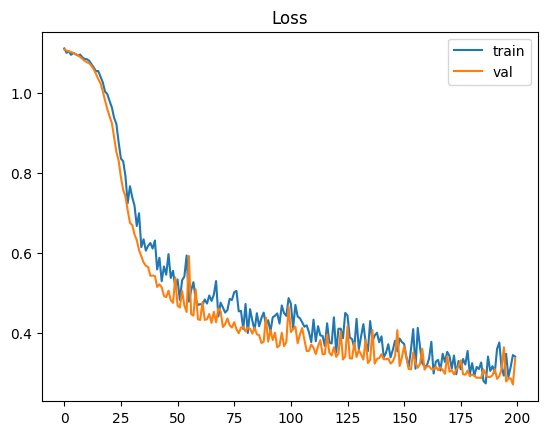

In [ ]:
# 3 авторов, с самым маленьким кол-вом текстов

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

model = Classifier(33, 40, class_weights.size()[0])
model = model.to(device)
opt = torch.optim.Adam(model.parameters(), lr=0.001)
log = []
early_stopper = 0
for epoch in tqdm(range(200)):
    epoch_loss = []
    epoch_val_loss = []
    for batched_graph, labels in train_dataloader:
        #print(batched_graph)
        feats = batched_graph.ndata['vec']
        feats = feats.to(device)
        batched_graph = batched_graph.to(device)
        # print(feats.shape)
        logits = model(batched_graph, feats).to(device)
        labels = labels.to(device)
        # print(labels)
        train_loss = F.cross_entropy(logits, labels, weight=class_weights)
        opt.zero_grad()
        train_loss.backward()
        opt.step()
        epoch_loss.append(train_loss.item())

    for batched_graph, labels in val_dataloader:
        with torch.no_grad():
            batched_graph = batched_graph.to(device)
            feats = batched_graph.ndata['vec']
            feats = feats.to(device)
            logits = model(batched_graph, feats)
            labels = labels.to(device)
            val_loss = F.cross_entropy(logits, labels, weight=class_weights)
            epoch_val_loss.append(val_loss.item())


    log.append([sum(epoch_loss)/len(epoch_loss), sum(epoch_val_loss)/len(epoch_val_loss)])
    if len(log) > 1 and log[-1][-1] > log[-2][-1]:
        early_stopper += 1
    else:
        early_stopper = 0
    if early_stopper == 5:
        break

plt.plot(np.array(log))
plt.title('Loss')
plt.legend(['train', 'val'])
plt.show()

Проверяем качество на тестовой выборке

In [ ]:
from sklearn.metrics import classification_report

with torch.no_grad():
  y_pred = []
  labels = []
  for batched_graph, label in test_dataloader:
    batched_graph = batched_graph.to(device)
    logits = model(batched_graph, batched_graph.ndata['vec'])
    for logit in logits:
      y_pred.append(torch.argmax(logit).cpu())
    # print(y_pred)
    labels.extend(label)
    # print(labels)
print(classification_report(labels, y_pred))

              precision    recall  f1-score   support

           0       0.73      0.92      0.81        12
           1       0.86      0.86      0.86        14
           2       0.82      0.64      0.72        14

    accuracy                           0.80        40
   macro avg       0.80      0.81      0.80        40
weighted avg       0.81      0.80      0.80        40


In [ ]:
from sklearn.metrics import balanced_accuracy_score
with torch.no_grad():
  y_pred = []
  labels = []
  for batched_graph, label in test_dataloader:
    batched_graph = batched_graph.to(device)
    logits = model(batched_graph, batched_graph.ndata['vec'])
    for logit in logits:
      y_pred.append(torch.argmax(logit).cpu())
    # print(y_pred)
    labels.extend(label)
    # print(labels)
score = balanced_accuracy_score(labels, y_pred)
print(f'Balanced accuracy: {score:.2f}')

Balanced accuracy: 0.81


<Axes: >

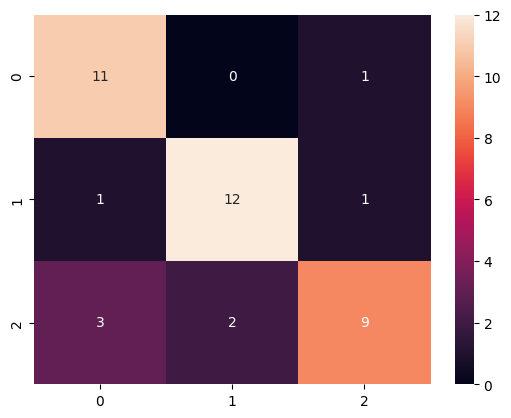

In [ ]:
from sklearn.metrics import confusion_matrix
import seaborn as sns

with torch.no_grad():
  y_pred = []
  labels = []
  for batched_graph, label in test_dataloader:
    batched_graph = batched_graph.to(device)
    logits = model(batched_graph, batched_graph.ndata['vec'])
    for logit in logits:
      y_pred.append(torch.argmax(logit).cpu())
    labels.extend(label)
sns.heatmap(confusion_matrix(labels, y_pred), annot=True)


# Вторая модель (3 самых больших автора)

100%|█████████████████████████████████████████████████████████████████████████████████| 200/200 [03:07<00:00,  1.07it/s]


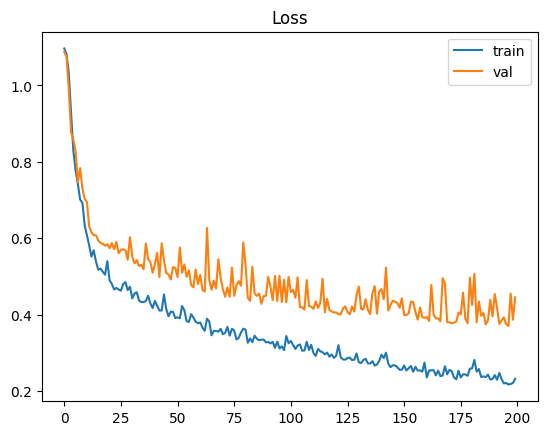

In [ ]:
# 3 автора с самым большим кол-вом текстов

model_2 = Classifier(33, 40, class_weights.size()[0])
model_2 = model_2.to(device)
#n_epochs = 500
opt = torch.optim.Adam(model_2.parameters(), lr=0.001)
log = []
early_stopper = 0
for epoch in tqdm(range(200)):
    epoch_loss = []
    epoch_val_loss = []
    for batched_graph, labels in train_dataloader:
        #print(batched_graph)
        batched_graph = batched_graph.to(device)
        feats = batched_graph.ndata['vec']

        # print(feats.shape)
        logits = model_2(batched_graph, feats).to(device)
        labels = labels.to(device)
        # print(labels)
        train_loss = F.cross_entropy(logits, labels, weight=class_weights)
        opt.zero_grad()
        train_loss.backward()
        opt.step()
        epoch_loss.append(train_loss.item())

    for batched_graph, labels in val_dataloader:
        with torch.no_grad():
            batched_graph = batched_graph.to(device)
            feats = batched_graph.ndata['vec']
            feats = feats.to(device)
            logits = model_2(batched_graph, feats)
            labels = labels.to(device)
            val_loss = F.cross_entropy(logits, labels, weight=class_weights)
            epoch_val_loss.append(val_loss.item())


    log.append([sum(epoch_loss)/len(epoch_loss), sum(epoch_val_loss)/len(epoch_val_loss)])

    if len(log) > 1 and log[-1][-1] > log[-2][-1]:
        early_stopper += 1
    else:
        early_stopper = 0
    if early_stopper == 5:
        break

plt.plot(np.array(log))
plt.title('Loss')
plt.legend(['train', 'val'])
plt.show()

In [ ]:
from sklearn.metrics import classification_report

with torch.no_grad():
  y_pred = []
  labels = []
  for batched_graph, label in test_dataloader:
    batched_graph = batched_graph.to(device)
    logits = model_2(batched_graph, batched_graph.ndata['vec'])
    for logit in logits:
      y_pred.append(torch.argmax(logit).cpu())
    # print(y_pred)
    labels.extend(label)
    # print(labels)
print(classification_report(labels, y_pred))

              precision    recall  f1-score   support

           0       0.88      0.86      0.87        77
           1       0.87      0.97      0.92       164
           2       0.98      0.87      0.92       144

    accuracy                           0.91       385
   macro avg       0.91      0.90      0.90       385
weighted avg       0.91      0.91      0.91       385


In [ ]:
from sklearn.metrics import balanced_accuracy_score
with torch.no_grad():
  y_pred = []
  labels = []
  for batched_graph, label in test_dataloader:
    batched_graph = batched_graph.to(device)
    logits = model_2(batched_graph, batched_graph.ndata['vec'])
    for logit in logits:
      y_pred.append(torch.argmax(logit).cpu())
    # print(y_pred)
    labels.extend(label)
    # print(labels)
score = balanced_accuracy_score(labels, y_pred)
print(f'Balanced accuracy: {score:.2f}')

Balanced accuracy: 0.90


<Axes: >

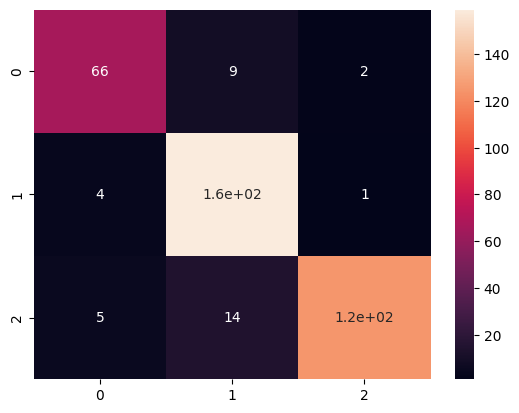

In [ ]:
from sklearn.metrics import confusion_matrix
import seaborn as sns

with torch.no_grad():
  y_pred = []
  labels = []
  for batched_graph, label in test_dataloader:
    batched_graph = batched_graph.to(device)
    logits = model_2(batched_graph, batched_graph.ndata['vec'])
    for logit in logits:
      y_pred.append(torch.argmax(logit).cpu())
    labels.extend(label)
sns.heatmap(confusion_matrix(labels, y_pred), annot=True)

# Третья модель (3 случайных автора)

100%|███████████████████████████████████████████████████████████████████████████| 200/200 [01:15<00:00,  2.64it/s]


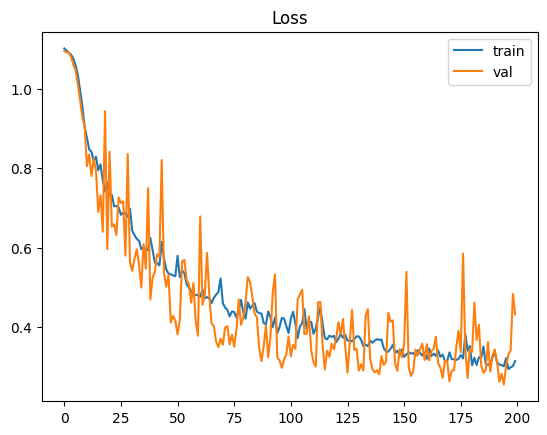

In [ ]:
# 3 случайных автора

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

model_3 = Classifier(33, 40, class_weights.size()[0])
model_3 = model_3.to(device)
opt = torch.optim.Adam(model_3.parameters(), lr=0.001)
log = []
early_stopper = 0
for epoch in tqdm(range(200)):
    epoch_loss = []
    epoch_val_loss = []
    for batched_graph, labels in train_dataloader:
        #print(batched_graph)
        feats = batched_graph.ndata['vec']
        feats = feats.to(device)
        batched_graph = batched_graph.to(device)
        # print(feats.shape)
        logits = model_3(batched_graph, feats).to(device)
        labels = labels.to(device)
        # print(labels)
        train_loss = F.cross_entropy(logits, labels, weight=class_weights)
        opt.zero_grad()
        train_loss.backward()
        opt.step()
        epoch_loss.append(train_loss.item())

    for batched_graph, labels in val_dataloader:
        with torch.no_grad():
            batched_graph = batched_graph.to(device)
            feats = batched_graph.ndata['vec']
            feats = feats.to(device)
            logits = model_3(batched_graph, feats)
            labels = labels.to(device)
            val_loss = F.cross_entropy(logits, labels, weight=class_weights)
            epoch_val_loss.append(val_loss.item())


    log.append([sum(epoch_loss)/len(epoch_loss), sum(epoch_val_loss)/len(epoch_val_loss)])
    if len(log) > 1 and log[-1][-1] > log[-2][-1]:
        early_stopper += 1
    else:
        early_stopper = 0
    if early_stopper == 5:
        break

plt.plot(np.array(log))
plt.title('Loss')
plt.legend(['train', 'val'])
plt.show()

In [ ]:
from sklearn.metrics import classification_report

with torch.no_grad():
  y_pred = []
  labels = []
  for batched_graph, label in test_dataloader:
    batched_graph = batched_graph.to(device)
    logits = model_3(batched_graph, batched_graph.ndata['vec'])
    for logit in logits:
      y_pred.append(torch.argmax(logit).cpu())
    # print(y_pred)
    labels.extend(label)
    # print(labels)
print(classification_report(labels, y_pred))

              precision    recall  f1-score   support

           0       0.66      0.91      0.76        32
           1       0.95      0.90      0.92        87
           2       0.78      0.56      0.65        25

    accuracy                           0.84       144
   macro avg       0.80      0.79      0.78       144
weighted avg       0.86      0.84      0.84       144


In [ ]:
from sklearn.metrics import balanced_accuracy_score
with torch.no_grad():
  y_pred = []
  labels = []
  for batched_graph, label in test_dataloader:
    batched_graph = batched_graph.to(device)
    logits = model_3(batched_graph, batched_graph.ndata['vec'])
    for logit in logits:
      y_pred.append(torch.argmax(logit).cpu())
    # print(y_pred)
    labels.extend(label)
    # print(labels)
score = balanced_accuracy_score(labels, y_pred)
print(f'Balanced accuracy: {score:.2f}')

Balanced accuracy: 0.79


<Axes: >

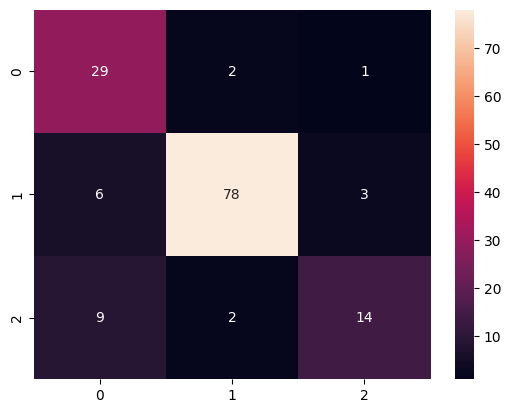

In [ ]:
from sklearn.metrics import confusion_matrix
import seaborn as sns

with torch.no_grad():
  y_pred = []
  labels = []
  for batched_graph, label in test_dataloader:
    batched_graph = batched_graph.to(device)
    logits = model_3(batched_graph, batched_graph.ndata['vec'])
    for logit in logits:
      y_pred.append(torch.argmax(logit).cpu())
    labels.extend(label)
sns.heatmap(confusion_matrix(labels, y_pred), annot=True)

# Четвертая модель (все авторы)

100%|█████████████████████████████████████████████████████████████████████████████████| 300/300 [06:39<00:00,  1.33s/it]


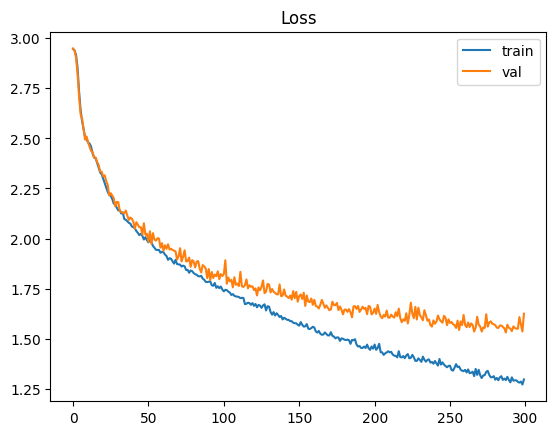

In [ ]:
# Все авторы (кроме тех, кого ыкинули в dgldataset)

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

model_4 = Classifier(33, 40, class_weights.size()[0])
model_4 = model_4.to(device)
opt = torch.optim.Adam(model_4.parameters(), lr=0.001)
log = []
early_stopper = 0
for epoch in tqdm(range(300)):
    epoch_loss = []
    epoch_val_loss = []
    for batched_graph, labels in train_dataloader:
        #print(batched_graph)
        feats = batched_graph.ndata['vec']
        feats = feats.to(device)
        batched_graph = batched_graph.to(device)
        # print(feats.shape)
        logits = model_4(batched_graph, feats).to(device)
        labels = labels.to(device)
        # print(labels)
        train_loss = F.cross_entropy(logits, labels, weight=class_weights)
        opt.zero_grad()
        train_loss.backward()
        opt.step()
        epoch_loss.append(train_loss.item())

    for batched_graph, labels in val_dataloader:
        with torch.no_grad():
            batched_graph = batched_graph.to(device)
            feats = batched_graph.ndata['vec']
            feats = feats.to(device)
            logits = model_4(batched_graph, feats)
            labels = labels.to(device)
            val_loss = F.cross_entropy(logits, labels, weight=class_weights)
            epoch_val_loss.append(val_loss.item())


    log.append([sum(epoch_loss)/len(epoch_loss), sum(epoch_val_loss)/len(epoch_val_loss)])
    if len(log) > 1 and log[-1][-1] > log[-2][-1]:
        early_stopper += 1
    else:
        early_stopper = 0
    if early_stopper == 5:
        break

plt.plot(np.array(log))
plt.title('Loss')
plt.legend(['train', 'val'])
plt.show()

In [ ]:
from sklearn.metrics import classification_report

with torch.no_grad():
  y_pred = []
  labels = []
  for batched_graph, label in test_dataloader:
    batched_graph = batched_graph.to(device)
    logits = model_4(batched_graph, batched_graph.ndata['vec'])
    for logit in logits:
      y_pred.append(torch.argmax(logit).cpu())
    # print(y_pred)
    labels.extend(label)
    # print(labels)
print(classification_report(labels, y_pred))

              precision    recall  f1-score   support

           0       0.29      0.92      0.44        13
           1       0.50      0.34      0.41        44
           2       0.43      0.86      0.57        14
           3       0.73      0.50      0.59        16
           4       0.84      0.48      0.61        44
           5       0.18      0.20      0.19        30
           6       0.56      0.89      0.68        45
           7       0.70      0.64      0.67        78
           8       0.56      0.52      0.54        27
           9       0.75      0.71      0.73        42
          10       0.83      0.52      0.64       147
          11       0.79      0.46      0.58        24
          12       0.28      0.48      0.36        31
          13       0.37      0.44      0.40        16
          14       0.39      0.78      0.52        41
          15       0.56      0.40      0.47        70
          16       0.36      0.48      0.42        33
          17       0.81    

In [ ]:
from sklearn.metrics import balanced_accuracy_score
with torch.no_grad():
  y_pred = []
  labels = []
  for batched_graph, label in test_dataloader:
    batched_graph = batched_graph.to(device)
    logits = model_4(batched_graph, batched_graph.ndata['vec'])
    for logit in logits:
      y_pred.append(torch.argmax(logit).cpu())
    # print(y_pred)
    labels.extend(label)
    # print(labels)
score = balanced_accuracy_score(labels, y_pred)
print(f'Balanced accuracy: {score:.2f}')

Balanced accuracy: 0.57


<Axes: >

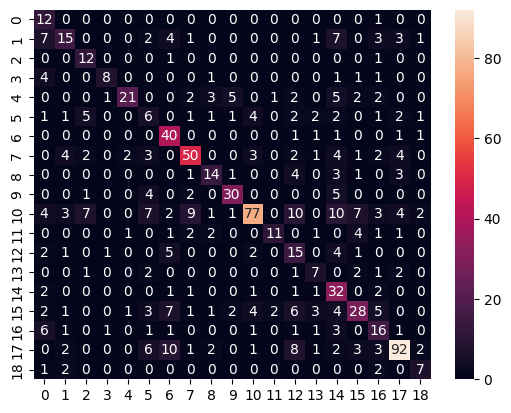

In [ ]:
from sklearn.metrics import confusion_matrix
import seaborn as sns

with torch.no_grad():
  y_pred = []
  labels = []
  for batched_graph, label in test_dataloader:
    batched_graph = batched_graph.to(device)
    logits = model_4(batched_graph, batched_graph.ndata['vec'])
    for logit in logits:
      y_pred.append(torch.argmax(logit).cpu())
    labels.extend(label)
sns.heatmap(confusion_matrix(labels, y_pred), annot=True)

# Пятая модель (14 авторов)

100%|█████████████████████████████████████████████████████████████████████| 300/300 [04:50<00:00,  1.03it/s]


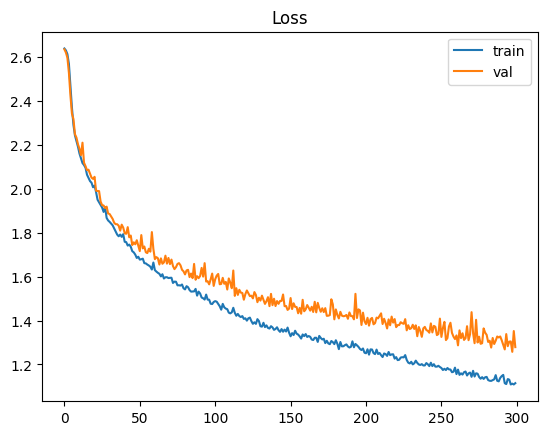

In [ ]:
# 14 авторов

device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

model_5 = Classifier(33, 40, class_weights.size()[0])
model_5 = model_5.to(device)
opt = torch.optim.Adam(model_5.parameters(), lr=0.001)
log = []
early_stopper = 0
for epoch in tqdm(range(300)):
    epoch_loss = []
    epoch_val_loss = []
    for batched_graph, labels in train_dataloader:
        #print(batched_graph)
        feats = batched_graph.ndata['vec']
        feats = feats.to(device)
        batched_graph = batched_graph.to(device)
        # print(feats.shape)
        logits = model_5(batched_graph, feats).to(device)
        labels = labels.to(device)
        # print(labels)
        train_loss = F.cross_entropy(logits, labels, weight=class_weights)
        opt.zero_grad()
        train_loss.backward()
        opt.step()
        epoch_loss.append(train_loss.item())

    for batched_graph, labels in val_dataloader:
        with torch.no_grad():
            batched_graph = batched_graph.to(device)
            feats = batched_graph.ndata['vec']
            feats = feats.to(device)
            logits = model_5(batched_graph, feats)
            labels = labels.to(device)
            val_loss = F.cross_entropy(logits, labels, weight=class_weights)
            epoch_val_loss.append(val_loss.item())


    log.append([sum(epoch_loss)/len(epoch_loss), sum(epoch_val_loss)/len(epoch_val_loss)])
    if len(log) > 1 and log[-1][-1] > log[-2][-1]:
        early_stopper += 1
    else:
        early_stopper = 0
    if early_stopper == 5:
        break

plt.plot(np.array(log))
plt.title('Loss')
plt.legend(['train', 'val'])
plt.show()

In [ ]:
from sklearn.metrics import classification_report

with torch.no_grad():
  y_pred = []
  labels = []
  for batched_graph, label in test_dataloader:
    batched_graph = batched_graph.to(device)
    logits = model_5(batched_graph, batched_graph.ndata['vec'])
    for logit in logits:
      y_pred.append(torch.argmax(logit).cpu())
    # print(y_pred)
    labels.extend(label)
    # print(labels)
print(classification_report(labels, y_pred))

              precision    recall  f1-score   support

           0       0.46      0.57      0.51        44
           1       0.43      0.72      0.54        29
           2       0.35      0.26      0.30        27
           3       0.88      0.76      0.81        46
           4       0.59      0.70      0.64        96
           5       0.25      0.63      0.36        19
           6       0.78      0.85      0.81        41
           7       0.86      0.50      0.63       158
           8       0.54      0.65      0.59        23
           9       0.29      0.43      0.35        23
          10       0.62      0.42      0.50        36
          11       0.50      0.59      0.54        74
          12       0.59      0.36      0.44        28
          13       0.81      0.77      0.79       143

    accuracy                           0.62       787
   macro avg       0.57      0.59      0.56       787
weighted avg       0.66      0.62      0.62       787


In [ ]:
from sklearn.metrics import balanced_accuracy_score
with torch.no_grad():
  y_pred = []
  labels = []
  for batched_graph, label in test_dataloader:
    batched_graph = batched_graph.to(device)
    logits = model_5(batched_graph, batched_graph.ndata['vec'])
    for logit in logits:
      y_pred.append(torch.argmax(logit).cpu())
    # print(y_pred)
    labels.extend(label)
    # print(labels)
score = balanced_accuracy_score(labels, y_pred)
print(f'Balanced accuracy: {score:.2f}')

Balanced accuracy: 0.59


<Axes: >

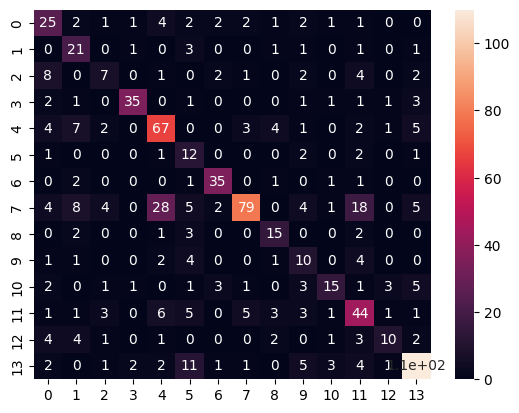

In [ ]:
from sklearn.metrics import confusion_matrix
import seaborn as sns

with torch.no_grad():
  y_pred = []
  labels = []
  for batched_graph, label in test_dataloader:
    batched_graph = batched_graph.to(device)
    logits = model_5(batched_graph, batched_graph.ndata['vec'])
    for logit in logits:
      y_pred.append(torch.argmax(logit).cpu())
    labels.extend(label)
sns.heatmap(confusion_matrix(labels, y_pred), annot=True)

# Объединение архитектур

Создаётся doc2vec прямо в датасете

In [4]:
#upd

from dgl.data import DGLDataset
from gensim.models.doc2vec import Doc2Vec, TaggedDocument

class GraphDataset(DGLDataset):
  def __init__(self, raw_dir='raw_data', save_dir='./save', verbose=True):
    self._data = None
    self._tags = None
    super().__init__(name='graph_dataset', raw_dir=raw_dir, save_dir=save_dir, verbose=verbose)

  def download(self):
    with open(self.raw_dir + './graphs_full_mystem_cleaned_5.pkl', 'rb') as f:
      self._data = dill.load(f)

  def process(self):
    self._tags = self._get_taglist()
    self._vectorize()

    tqdm.pandas(desc='converting graphs', colour='#e87d1a')
    self._data['graph'] = self._data['graph'].progress_apply(lambda x: dgl.from_networkx(x.G, node_attrs=['vec']))
    self._data['author'] = self._data['filename'].apply(lambda x: int(x.split('_')[0]))
    self._data['author'] = pd.factorize(self._data['author'])[0]
    self._data = self._data[['preprocessed_text', 'graph', 'author']]
    self._make_d2v()

  def save(self):
    with open(f'{self.save_dir}/{self.name}.pkl', 'wb') as f:
      dill.dump(self._data, f)

  def load(self):
    with open(f'{self.save_dir}/{self.name}.pkl', 'rb') as f:
      self._data = dill.load(f)
    self._data = self._data.loc[(self._data['author'] != 0) & (self._data['author'] != 6) & (self._data['author'] != 21)]
    self._data['author'] = pd.factorize(self._data['author'])[0]
    self._data = self._data.loc[self._data['author'] != 13]
    self._data['author'] = pd.factorize(self._data['author'])[0]

  def has_cache(self):
    return os.path.exists(f'{self.save_dir}/{self.name}.pkl')

  def _get_taglist(self):
    tags = []
    for graph in self._data['graph']:
      for node in graph.G.nodes:
        tags.append(node[1])
    return tuple(set(tags))

  def _vectorize(self):
    w2v_vectors = self._make_w2v()
    for graph in tqdm(self._data['graph']):
      for node in tuple(graph.G.nodes):
        ohe = self._make_ohe(node)
        w2v = w2v_vectors[node[0]]
        graph.G.nodes[node]['vec'] = ohe + list(w2v)

  def _make_ohe(self, node):
    # class_tp = ('A', 'ADV', 'ADVPRO', 'ANUM', 'APRO', 'COM', 'CONJ', 'INTJ', 'NUM', 'PART', 'PR', 'S', 'SPRO', 'V', 'ENG', 'PUNCT', 'UNK')
    vec = [0] * len(self._tags)
    vec[self._tags.index(node[1])] = 1
    # graph.G.nodes[pair]['ohe'] = vec
    return vec

  def _make_w2v(self):
    texts = self._data['preprocessed_text'].apply(lambda text: [token[0] for token in text])
    w2v = Word2Vec(texts, vector_size=16, min_count=1, window=5, seed=42, workers=3, sg=1, negative=5, epochs=5) #hs=1 for big vocab
    vectors = w2v.wv
    vectors.save(self.save_dir + '/word2vec.wordvectors')
    return vectors

  def _make_d2v(self):
    texts = self._data['preprocessed_text'].apply(lambda text: [token[0] for token in text])
    tagged_corpus = [TaggedDocument(words=text, tags=[str(i)]) for i, text in enumerate(texts.to_list())]
    d2v = Doc2Vec(vector_size=33, min_count=1, epochs=50, seed=42)
    d2v.build_vocab(tagged_corpus)
    d2v.train(tagged_corpus, total_examples=d2v.corpus_count, epochs=d2v.epochs)
    self._data['d2v'] = [d2v.infer_vector(text) for text in texts]

  @property
  def data(self):
    return self._data

  def __len__(self):
    return len(self._data)

  def __getitem__(self, ind):
    return self._data['graph'].iloc[ind], torch.tensor(self._data['author'].iloc[ind]), self._data['d2v'].iloc[ind]

In [36]:
graph_dataset = GraphDataset(raw_dir=r'')

Done loading data from cached files.


In [37]:
authors = graph_dataset._data.value_counts('author')
authors

author
10    857
17    641
7     421
15    315
1     240
4     213
6     203
9     202
14    165
16    149
5     146
8     136
12    125
11    114
2      93
3      79
13     67
18     65
0      64
Name: count, dtype: int64

In [7]:
from random import choice

def random_gen(n_authors_to_generate):
    excl = []
    rand_authors = []
    for i in range(n_authors_to_generate):
        rand_author = choice([i for i in range(len(authors)) if i not in excl])
        excl.append(rand_author)
        rand_authors.append(rand_author)
    return rand_authors

graph_dataset._data = graph_dataset._data.loc[~graph_dataset._data['author'].isin([i for i in authors.index if authors[i] < 100])]
# graph_dataset._data = graph_dataset._data.loc[graph_dataset._data['author'].isin([i for i in authors.index[-3:]])]
# graph_dataset._data = graph_dataset._data.loc[graph_dataset._data['author'].isin([i for i in authors.index[:3]])]

# random_authors = random_gen(3)
# graph_dataset._data = graph_dataset._data.loc[graph_dataset._data['author'].isin([i for i in random_authors])]

graph_dataset._data['author'] = pd.factorize(graph_dataset._data['author'])[0]

In [8]:
authors = graph_dataset._data.value_counts('author')
authors

author
7     857
13    641
4     421
11    315
0     240
1     213
3     203
6     202
10    165
12    149
2     146
5     136
9     125
8     114
Name: count, dtype: int64

Разделяем датасет на три выборки: тренировочную, валидационную и тестовую

In [38]:
from dgl.data.utils import split_dataset

split = split_dataset(graph_dataset, frac_list=[0.7, 0.1, 0.2], shuffle=True, random_state=42)
split

Даталоадер для всех трёх выборок

In [39]:
#upd

from dgl.dataloading import GraphDataLoader
batch_size = 64
train_dataloader = GraphDataLoader(
    split[0],
    batch_size=batch_size,
    drop_last=False,
    shuffle=True,
)
val_dataloader = GraphDataLoader(
    split[1],
    batch_size=batch_size,
    drop_last=False,
    shuffle=False)
test_dataloader = GraphDataLoader(
    split[2],
    batch_size=batch_size,
    drop_last=False,
    shuffle=False)

In [40]:
#new
classes = []
for y in train_dataloader:
  classes.extend(y[1].numpy().astype(np.int64))

In [41]:
#new
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

class_weights = compute_class_weight(class_weight='balanced', classes=np.unique(classes), y=classes)
class_weights = torch.Tensor(class_weights)
class_weights = class_weights.to(device)
class_weights

tensor([3.6793, 0.9417, 2.3266, 2.7278, 1.0618, 1.5213, 1.1142, 0.5104, 1.5664,
        1.1221, 0.2619, 2.0547, 2.1095, 3.9553, 1.3878, 0.7428, 1.5664, 0.3508,
        3.3662], device='cuda:0')

In [42]:
class_weights.size()[0]

19

## Model definition

Создание модели

In [14]:
import dgl.nn.pytorch as dglnn
import torch.nn as nn
import torch.nn.functional as F

class Classifier(nn.Module):
    def __init__(self, in_dim, hidden_dim, n_classes):
        super(Classifier, self).__init__()
        self.conv1 = dglnn.GraphConv(in_dim, hidden_dim)
        self.conv2 = dglnn.GraphConv(hidden_dim, hidden_dim)
        self.conv3 = dglnn.GraphConv(hidden_dim, hidden_dim)
        # self.conv4 = dglnn.GraphConv(hidden_dim, hidden_dim)
        self.classify = nn.Linear(hidden_dim + in_dim, n_classes)

    def forward(self, g, h, d2v):
        # Apply graph convolution and activation.
        with g.local_scope():
          num_nodes = g.batch_num_nodes()
          num_edges = g.batch_num_edges()
          g = dgl.add_self_loop(g)
          g.set_batch_num_nodes(num_nodes)
          g.set_batch_num_edges(num_edges)
        h = F.relu(self.conv1(g, h))
        h = F.relu(self.conv2(g, h))
        h = F.relu(self.conv3(g, h))
        # h = F.relu(self.conv4(g, h))
        with g.local_scope():
            g.ndata['h'] = h
            # Calculate graph representation by average readout.
            hg = dgl.mean_nodes(g, 'h')
            hg = torch.stack([torch.cat((hg[i], d2v[i])) for i in range(g.batch_size)])
            return self.classify(hg)

## Модель 19 авторов

Бейзлайн (прогоняем тестовую выборку)

In [43]:
from sklearn.metrics import classification_report

model = Classifier(33, 20, class_weights.size()[0])

with torch.no_grad():
  y_pred = []
  labels = []
  for batched_graph, label, d2v_vecs in test_dataloader:
    logits = model(batched_graph, batched_graph.ndata['vec'], d2v_vecs)
    for logit in logits:
      y_pred.append(torch.argmax(logit))
    # print(y_pred)
    labels.extend(label)
    # print(labels)
print(classification_report(labels, y_pred))

              precision    recall  f1-score   support

           0       0.00      0.00      0.00        13
           1       0.00      0.00      0.00        44
           2       0.01      0.14      0.02        14
           3       0.00      0.00      0.00        16
           4       0.03      0.05      0.03        44
           5       0.00      0.00      0.00        30
           6       0.00      0.00      0.00        45
           7       0.00      0.00      0.00        78
           8       0.11      0.04      0.06        27
           9       0.25      0.02      0.04        42
          10       0.17      0.01      0.03       147
          11       0.15      0.75      0.24        24
          12       0.00      0.00      0.00        31
          13       0.01      0.06      0.02        16
          14       0.06      0.05      0.05        41
          15       0.00      0.00      0.00        70
          16       0.00      0.00      0.00        33
          17       0.14    

/mnt/c/users/1/desktop/karina_diploma/diploma_work_2024/src/lin_note/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/mnt/c/users/1/desktop/karina_diploma/diploma_work_2024/src/lin_note/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
/mnt/c/users/1/desktop/karina_diploma/diploma_work_2024/src/lin_note/lib/python3.11/site-packages/sklearn/metrics/_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use 

Обучаем модель

100%|███████████████████████████████████████████████████████████████████████| 40/40 [01:03<00:00,  1.59s/it]


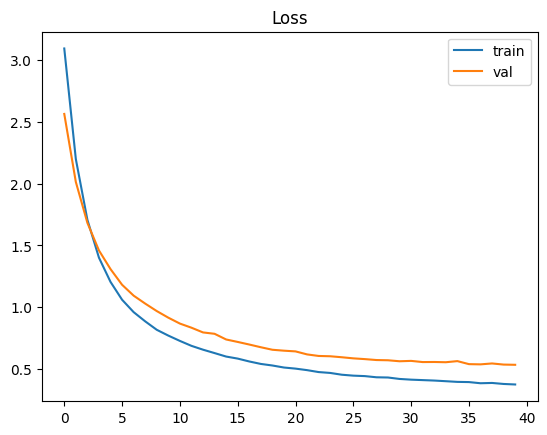

In [62]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

model = Classifier(33, 20, class_weights.size()[0])
model = model.to(device)
opt = torch.optim.Adam(model.parameters(), lr=0.001, weight_decay=0.001)
log = []

for epoch in tqdm(range(40)):
  epoch_loss = []
  epoch_val_loss = []
  for batched_graph, labels, d2v_vecs in train_dataloader:
    #print(batched_graph)
    feats = batched_graph.ndata['vec']
    feats = feats.to(device)
    batched_graph = batched_graph.to(device)
    d2v_vecs = d2v_vecs.to(device)
    # print(feats.shape)
    logits = model(batched_graph, feats, d2v_vecs).to(device)
    labels = labels.to(device)
    # print(labels)
    train_loss = F.cross_entropy(logits, labels, weight=class_weights)
    opt.zero_grad()
    train_loss.backward()
    opt.step()
    epoch_loss.append(train_loss.item())

  for batched_graph, labels, d2v_vecs in val_dataloader:
    with torch.no_grad():
        batched_graph = batched_graph.to(device)
        feats = batched_graph.ndata['vec']
        feats = feats.to(device)
        d2v_vecs = d2v_vecs.to(device)
        logits = model(batched_graph, feats, d2v_vecs).to(device)
        labels = labels.to(device)
        val_loss = F.cross_entropy(logits, labels, weight=class_weights)
        epoch_val_loss.append(val_loss.item())

  log.append([sum(epoch_loss)/len(epoch_loss), sum(epoch_val_loss)/len(epoch_val_loss)])

plt.plot(np.array(log))
plt.title('Loss')
plt.legend(['train', 'val'])
plt.show()

In [63]:
from sklearn.metrics import classification_report

with torch.no_grad():
  y_pred = []
  labels = []
  for batched_graph, label, d2v_vecs in test_dataloader:
    batched_graph = batched_graph.to(device)
    d2v_vecs = d2v_vecs.to(device)
    logits = model(batched_graph, batched_graph.ndata['vec'], d2v_vecs)
    #print(logits)
    for logit in logits:
      y_pred.append(torch.argmax(logit).cpu())
    # print(y_pred)
    labels.extend(label)
    # print(labels)
print(classification_report(labels, y_pred))

              precision    recall  f1-score   support

           0       0.87      1.00      0.93        13
           1       0.71      0.73      0.72        44
           2       0.72      0.93      0.81        14
           3       1.00      0.81      0.90        16
           4       0.93      0.95      0.94        44
           5       0.67      0.73      0.70        30
           6       0.95      0.93      0.94        45
           7       0.91      0.88      0.90        78
           8       0.78      0.78      0.78        27
           9       0.95      0.93      0.94        42
          10       0.97      0.88      0.93       147
          11       0.70      0.79      0.75        24
          12       0.73      0.77      0.75        31
          13       0.55      0.69      0.61        16
          14       0.88      0.88      0.88        41
          15       0.85      0.86      0.85        70
          16       0.72      0.85      0.78        33
          17       0.97    

## Модель 14 авторов

In [15]:
from sklearn.metrics import classification_report

model = Classifier(33, 20, class_weights.size()[0])

with torch.no_grad():
  y_pred = []
  labels = []
  for batched_graph, label, d2v_vecs in test_dataloader:
    logits = model(batched_graph, batched_graph.ndata['vec'], d2v_vecs)
    for logit in logits:
      y_pred.append(torch.argmax(logit))
    # print(y_pred)
    labels.extend(label)
    # print(labels)
print(classification_report(labels, y_pred))

              precision    recall  f1-score   support

           0       0.00      0.00      0.00        44
           1       0.17      0.55      0.26        29
           2       0.03      0.11      0.05        27
           3       0.23      0.54      0.32        46
           4       0.40      0.02      0.04        96
           5       0.00      0.00      0.00        19
           6       0.39      0.34      0.36        41
           7       0.20      0.03      0.05       158
           8       0.00      0.00      0.00        23
           9       0.18      0.13      0.15        23
          10       0.10      0.28      0.15        36
          11       0.13      0.14      0.13        74
          12       0.00      0.00      0.00        28
          13       0.28      0.08      0.12       143

    accuracy                           0.13       787
   macro avg       0.15      0.16      0.12       787
weighted avg       0.20      0.13      0.11       787



100%|███████████████████████████████████████████████████████████████████████| 40/40 [01:17<00:00,  1.93s/it]


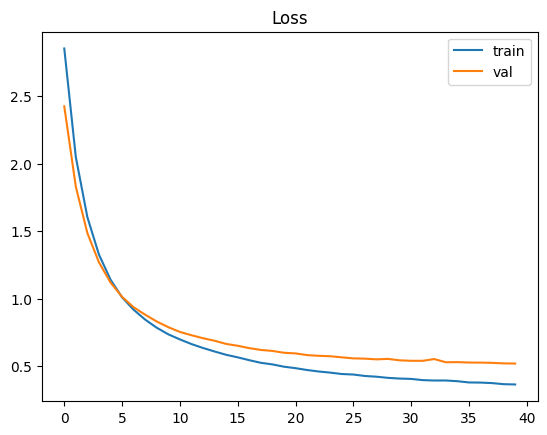

In [34]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

model_2 = Classifier(33, 20, class_weights.size()[0])
model_2 = model_2.to(device)
opt = torch.optim.Adam(model_2.parameters(), lr=0.001, weight_decay=0.001)
log = []

for epoch in tqdm(range(40)):
  epoch_loss = []
  epoch_val_loss = []
  for batched_graph, labels, d2v_vecs in train_dataloader:
    #print(batched_graph)
    feats = batched_graph.ndata['vec']
    feats = feats.to(device)
    batched_graph = batched_graph.to(device)
    d2v_vecs = d2v_vecs.to(device)
    # print(feats.shape)
    logits = model_2(batched_graph, feats, d2v_vecs).to(device)
    labels = labels.to(device)
    # print(labels)
    train_loss = F.cross_entropy(logits, labels, weight=class_weights)
    opt.zero_grad()
    train_loss.backward()
    opt.step()
    epoch_loss.append(train_loss.item())

  for batched_graph, labels, d2v_vecs in val_dataloader:
    with torch.no_grad():
        batched_graph = batched_graph.to(device)
        feats = batched_graph.ndata['vec']
        feats = feats.to(device)
        d2v_vecs = d2v_vecs.to(device)
        logits = model_2(batched_graph, feats, d2v_vecs).to(device)
        labels = labels.to(device)
        val_loss = F.cross_entropy(logits, labels, weight=class_weights)
        epoch_val_loss.append(val_loss.item())

  log.append([sum(epoch_loss)/len(epoch_loss), sum(epoch_val_loss)/len(epoch_val_loss)])

plt.plot(np.array(log))
plt.title('Loss')
plt.legend(['train', 'val'])
plt.show()

In [35]:
from sklearn.metrics import classification_report

with torch.no_grad():
  y_pred = []
  labels = []
  for batched_graph, label, d2v_vecs in test_dataloader:
    batched_graph = batched_graph.to(device)
    d2v_vecs = d2v_vecs.to(device)
    logits = model_2(batched_graph, batched_graph.ndata['vec'], d2v_vecs)
    #print(logits)
    for logit in logits:
      y_pred.append(torch.argmax(logit).cpu())
    # print(y_pred)
    labels.extend(label)
    # print(labels)
print(classification_report(labels, y_pred))

              precision    recall  f1-score   support

           0       0.77      0.77      0.77        44
           1       0.75      0.83      0.79        29
           2       0.73      0.81      0.77        27
           3       0.94      1.00      0.97        46
           4       0.94      0.91      0.92        96
           5       0.72      0.95      0.82        19
           6       0.95      1.00      0.98        41
           7       0.96      0.92      0.94       158
           8       0.79      0.83      0.81        23
           9       0.66      0.83      0.73        23
          10       0.94      0.83      0.88        36
          11       0.85      0.85      0.85        74
          12       0.79      0.82      0.81        28
          13       0.95      0.88      0.92       143

    accuracy                           0.89       787
   macro avg       0.84      0.87      0.85       787
weighted avg       0.89      0.89      0.89       787

